In [ ]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 91.6 MB/s eta 0:00:00


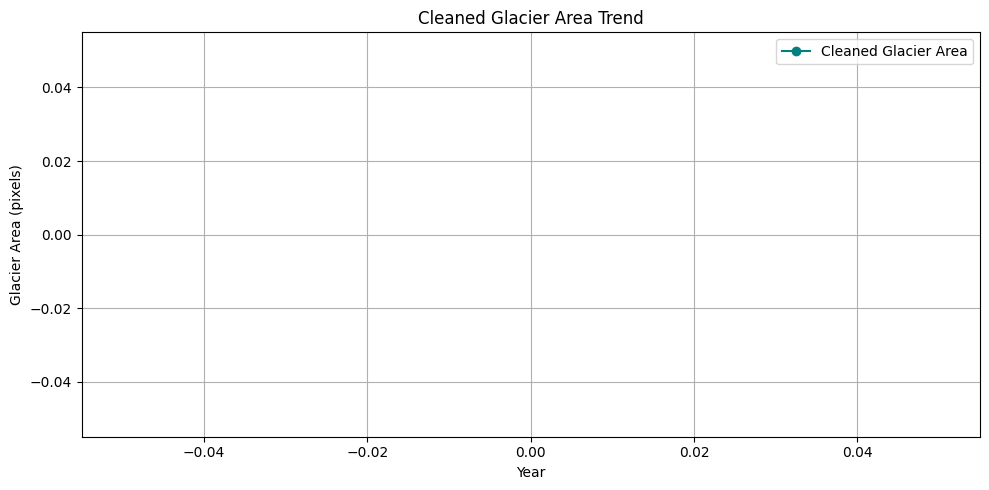

In [ ]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt
from rasterio.plot import show
from sklearn.preprocessing import MinMaxScaler
from skimage.filters import threshold_otsu

# -------- CONFIG ---------
image_path = '/content/drive/MyDrive/GEE_Khumbu_Exports-20250415T152007Z-001'
mask_output_path = '/content/drive/MyDrive/Glacier_Masks2'
os.makedirs(mask_output_path, exist_ok=True)

image_files = sorted([f for f in os.listdir(image_path) if f.endswith('.tif')])
years = list(range(2000, 2000 + len(image_files)))

# ----- Compute NDSI -----
def calculate_ndsi(image):
    green = image[0].astype(np.float32)  # Band 1 (Green)
    swir = image[2].astype(np.float32)   # Band 3 (SWIR1)
    epsilon = 1e-10
    ndsi = (green - swir) / (green + swir + epsilon)
    return np.nan_to_num(ndsi)

# ----- Compute NDVI -----
def calculate_ndvi(image):
    # Assuming NIR is in band 2 and Red is in band 0 if image has 3 bands
    nir = image[2].astype(np.float32) if image.shape[0] > 3 else image[2].astype(np.float32)
    red = image[0].astype(np.float32) if image.shape[0] > 3 else image[0].astype(np.float32)
    epsilon = 1e-10
    ndvi = (nir - red) / (nir + red + epsilon)
    return np.nan_to_num(ndvi)

# ----- Glacier Mask with Dynamic or Fixed Threshold -----
def create_glacier_mask(ndsi, threshold=None):
    if threshold is None:
        threshold = threshold_otsu(ndsi)
    glacier_mask = (ndsi > threshold).astype(np.uint8)
    return glacier_mask, threshold

# ----- Save Mask as GeoTIFF -----
def save_mask(mask, reference, output_path):
    with rasterio.open(
        output_path, 'w',
        driver='GTiff',
        height=mask.shape[0],
        width=mask.shape[1],
        count=1,
        dtype='uint8',
        crs=reference.crs,
        transform=reference.transform
    ) as dst:
        dst.write(mask, 1)


# ----- Main Loop -----
glacier_areas_raw = []
for i, f in enumerate(image_files):
    file_path = os.path.join(image_path, f)
    with rasterio.open(file_path) as src:
        img = src.read()
        ndsi = calculate_ndsi(img)
        ndvi = calculate_ndvi(img)

        glacier_mask, used_threshold = create_glacier_mask(ndsi, threshold=0.4)
        glacier_area = np.sum(glacier_mask)
        glacier_areas_raw.append(glacier_area)

        print(f"[✓] {f} | Area: {glacier_area} | Threshold: {used_threshold:.3f}")

        # Save mask
        mask_filename = f"glacier_mask_{years[i]}.tif"
        save_mask(glacier_mask, src, os.path.join(mask_output_path, mask_filename))

        # Visualization
        plt.figure(figsize=(15, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(ndsi, cmap='BrBG')
        plt.title(f'NDSI - {f}')
        plt.colorbar()

        plt.subplot(1, 3, 2)
        plt.imshow(glacier_mask, cmap='gray')
        plt.title(f'Glacier Mask - {f} (Threshold={used_threshold:.2f})')

        plt.subplot(1, 3, 3)
        plt.imshow(ndvi, cmap='YlGn')
        plt.title(f'NDVI - {f}')
        plt.colorbar()

        plt.tight_layout()
        plt.show()


# ----- Filter Out Corrupt Years -----
cleaned_years, cleaned_areas = [], []
for year, area in zip(years, glacier_areas_raw):
    if area > 5000:
        cleaned_years.append(year)
        cleaned_areas.append(area)
    else:
        print(f"[!] Skipped {year} - Low area ({area})")

# ----- Plot Glacier Area Trend -----
plt.figure(figsize=(10, 5))
plt.plot(cleaned_years, cleaned_areas, marker='o', color='teal', label='Cleaned Glacier Area')
plt.title("Cleaned Glacier Area Trend")
plt.xlabel("Year")
plt.ylabel("Glacier Area (pixels)")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


<ipython-input-5-ac1136de69ea>:46: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?
  mask_cleaned = remove_small_holes(mask_cleaned, area_threshold=100)


[✓] Gangotri_L78_2011.tif | Area: 44630.000 | Threshold: 0.283


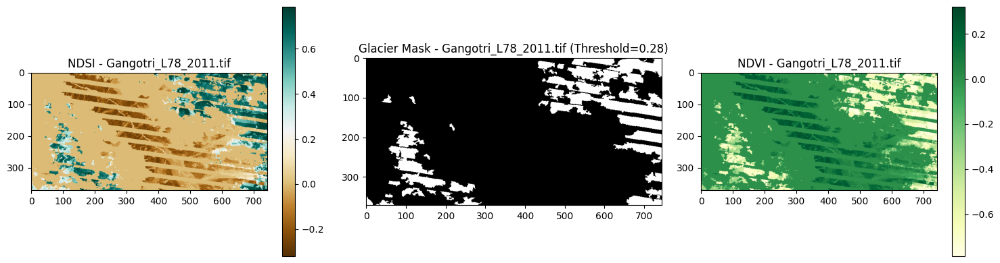

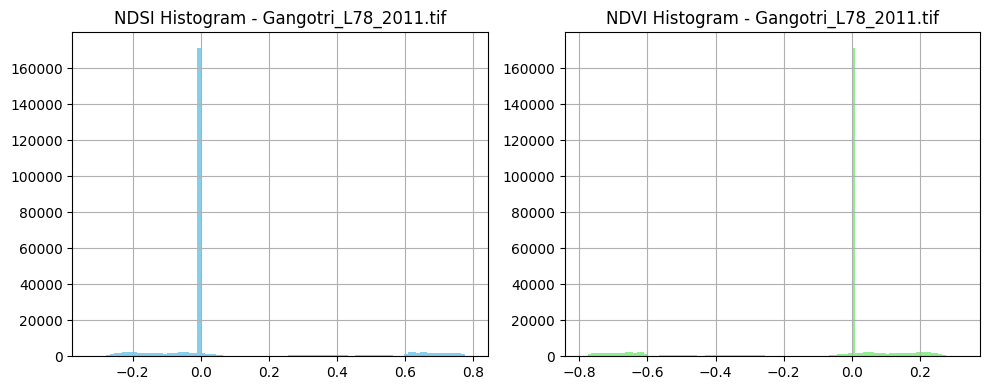

[✓] Gangotri_L78_2012.tif | Area: 64320.000 | Threshold: 0.240


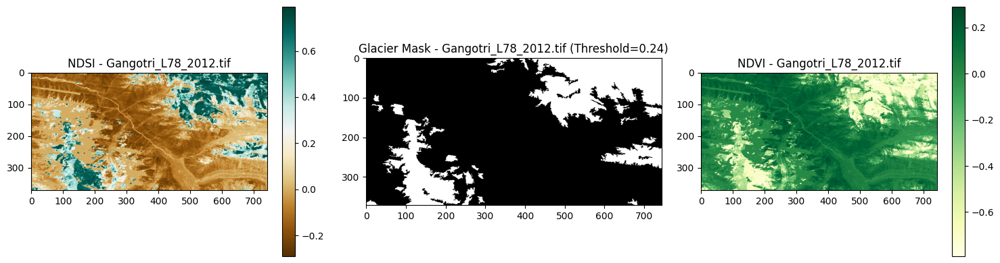

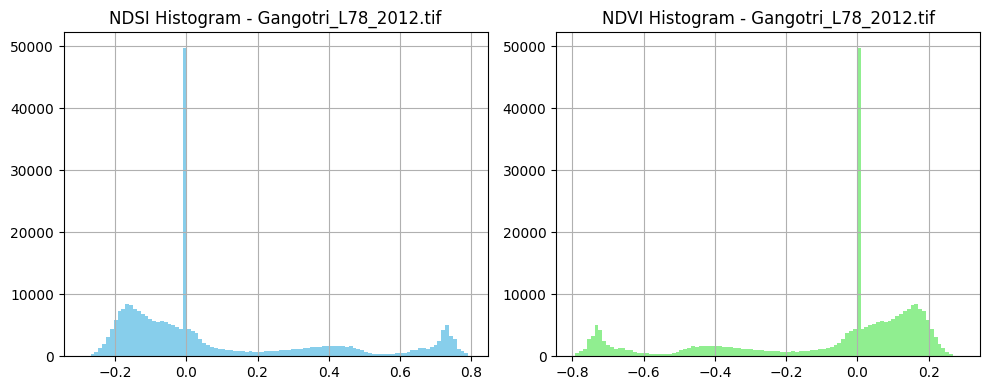

[✓] Gangotri_L78_2013.tif | Area: 98363.000 | Threshold: 0.115


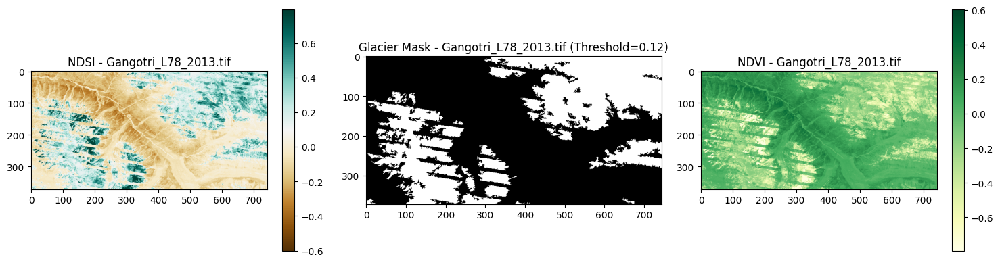

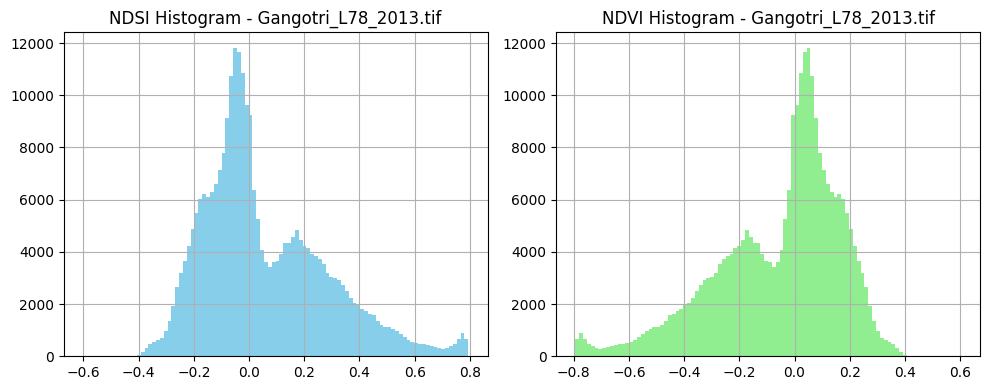

[✓] Gangotri_L78_2014.tif | Area: 77488.000 | Threshold: 0.105


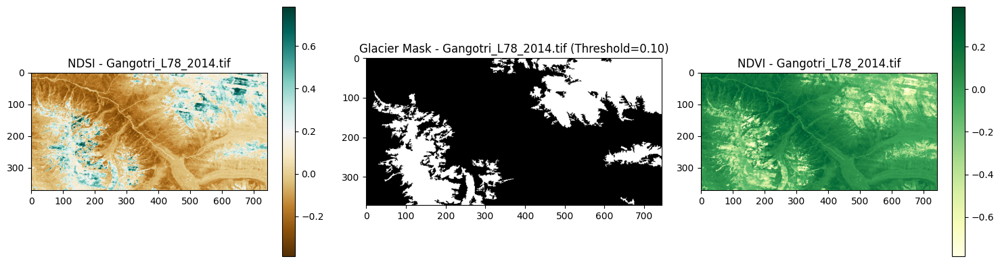

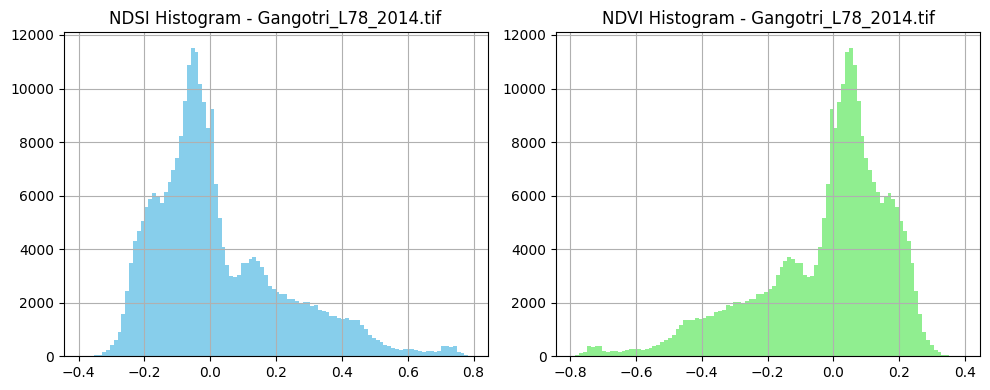

[✓] Gangotri_L78_2015.tif | Area: 98981.000 | Threshold: 0.218


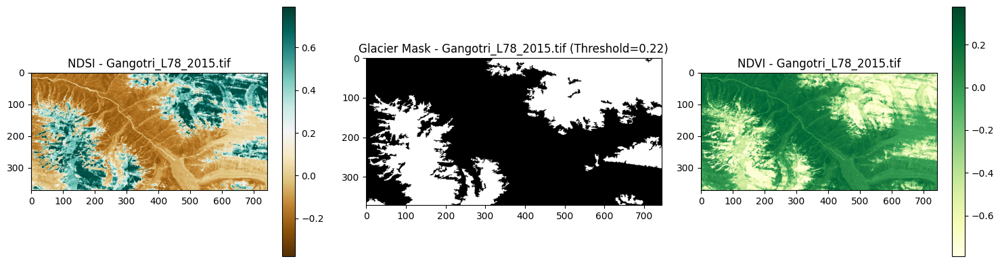

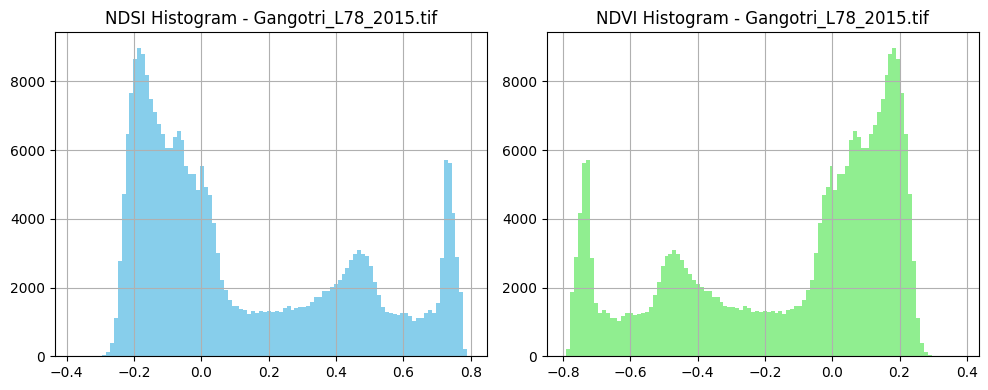

[✓] Gangotri_L7_2000.tif | Area: 44562.000 | Threshold: 0.277


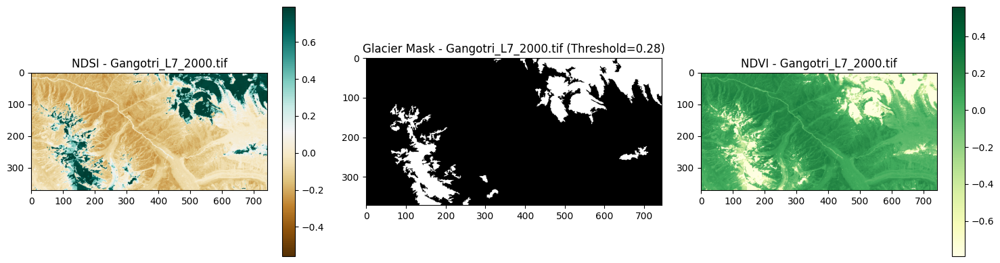

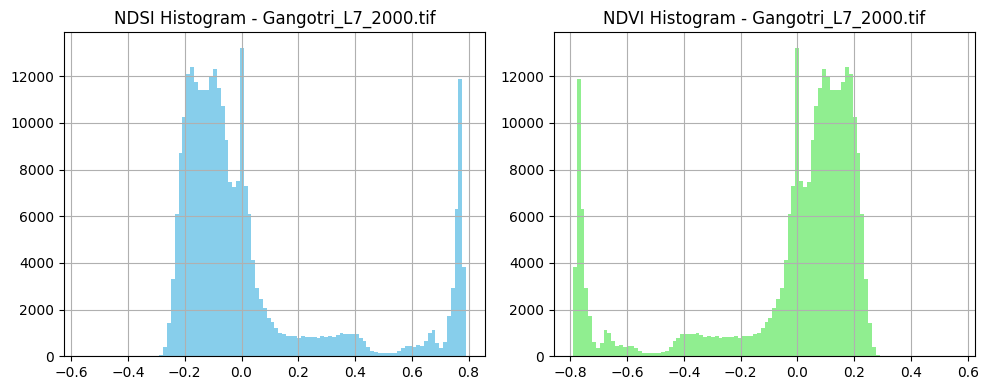

[✓] Gangotri_L7_2002.tif | Area: 87085.000 | Threshold: 0.236


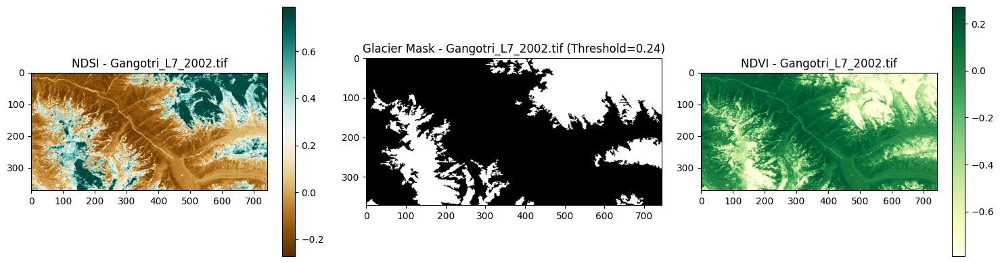

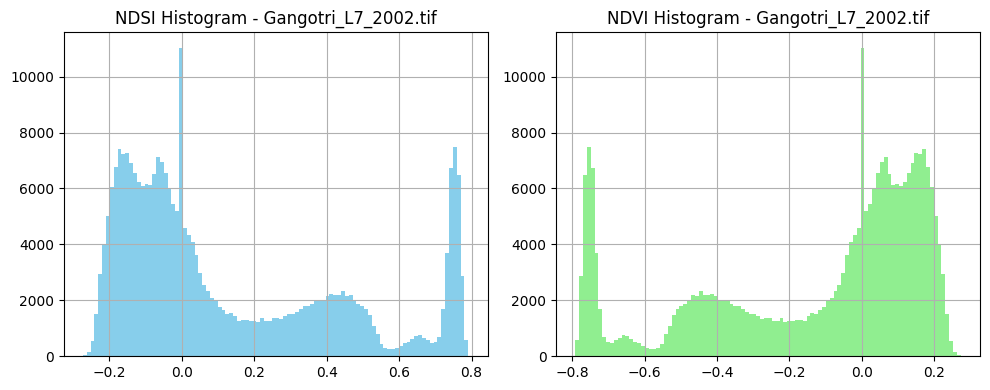

[✓] Gangotri_L7_2004.tif | Area: 48133.000 | Threshold: 0.214


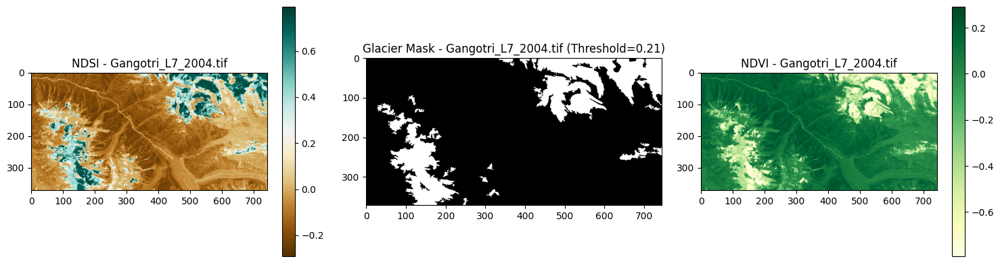

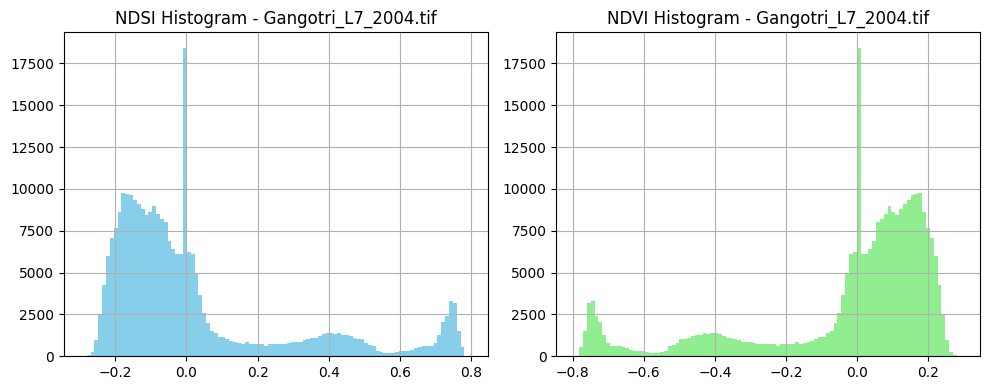

[✓] Gangotri_L7_2005.tif | Area: 92278.000 | Threshold: 0.245


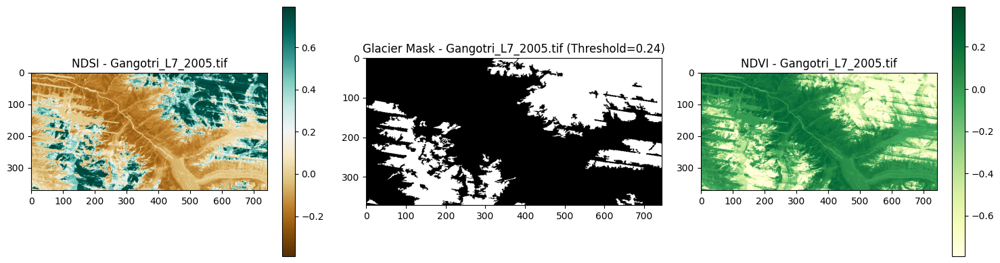

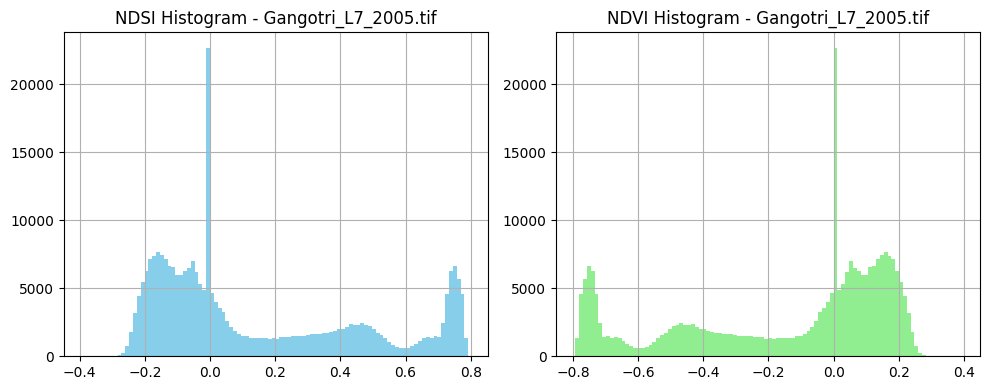

[✓] Gangotri_L7_2006.tif | Area: 29913.000 | Threshold: 0.228


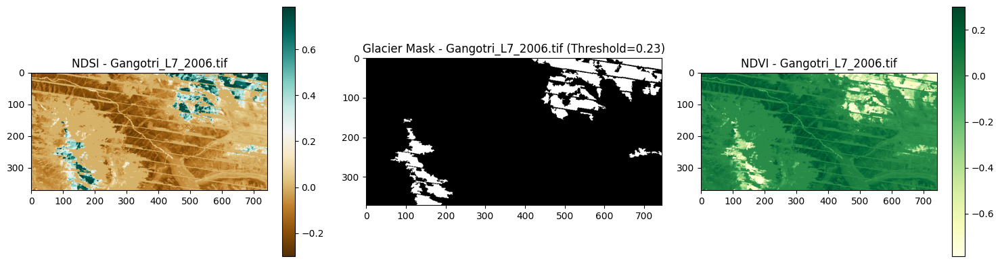

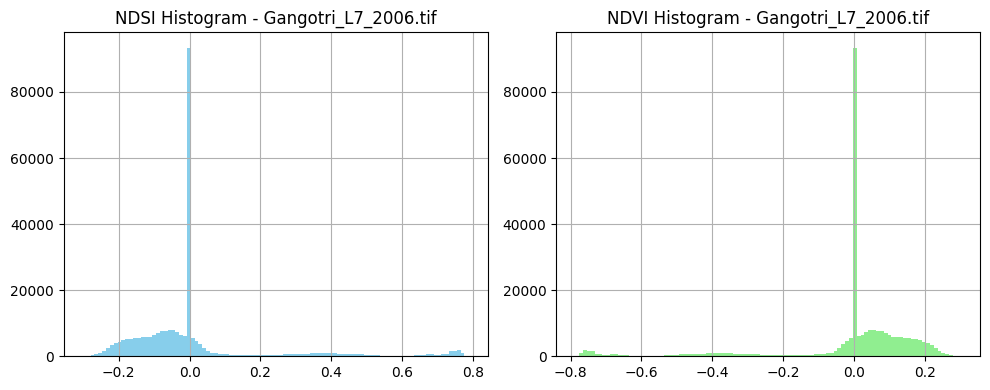

[✓] Gangotri_L7_2007.tif | Area: 78733.000 | Threshold: 0.243


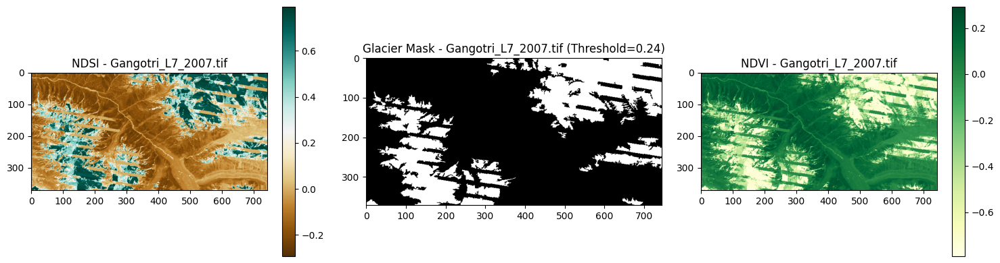

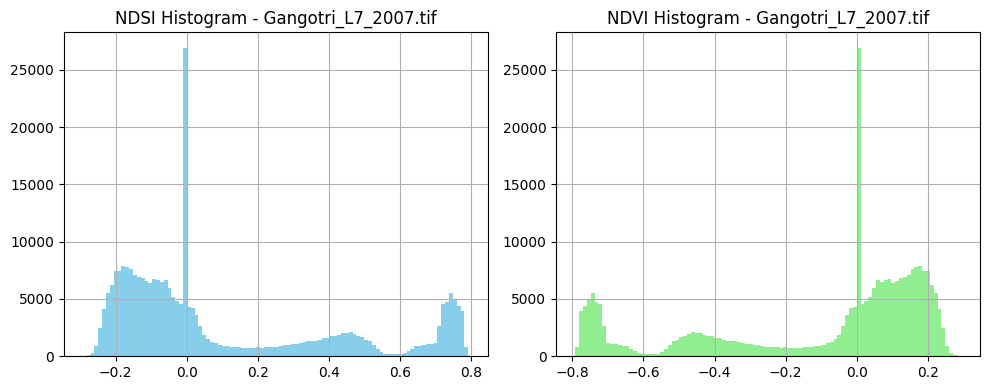

[✓] Gangotri_L7_2008.tif | Area: 27176.000 | Threshold: 0.213


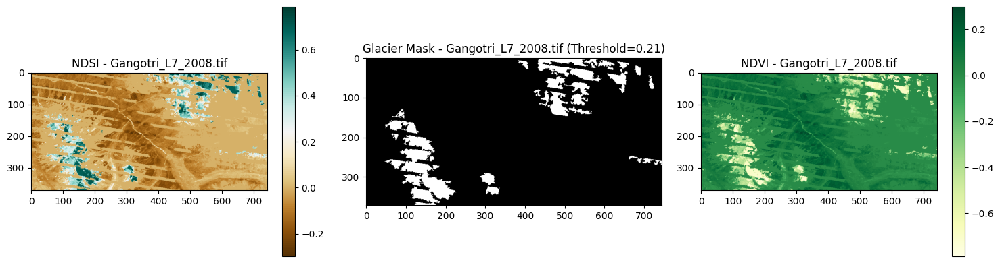

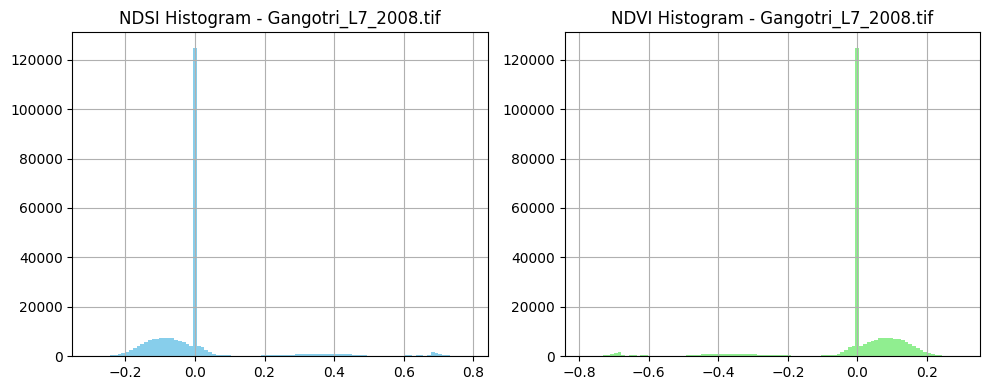

[✓] Gangotri_L7_2009.tif | Area: 73143.000 | Threshold: 0.228


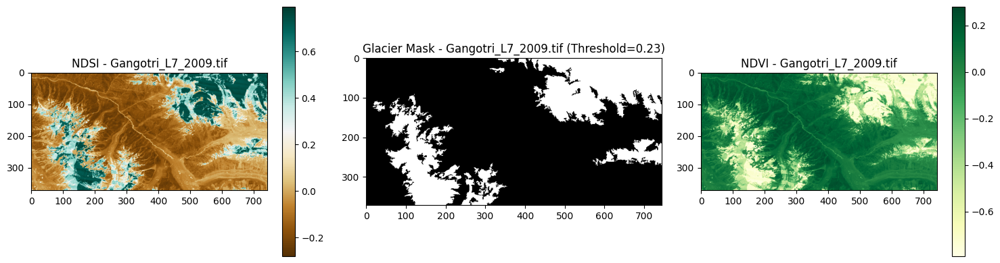

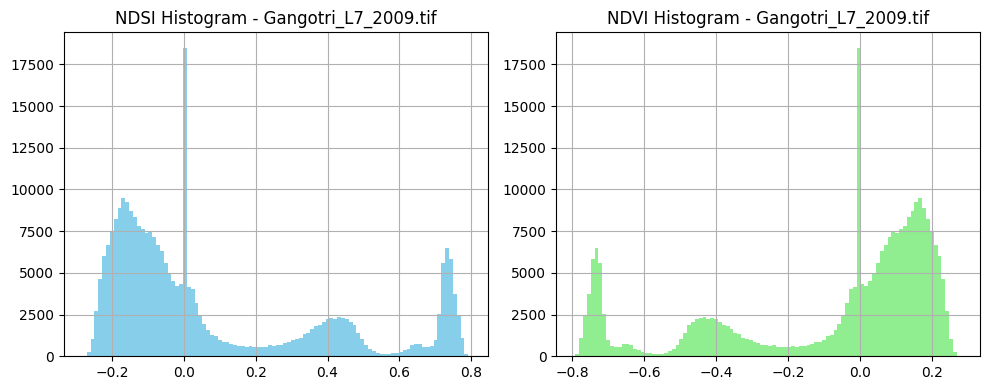

[✓] Gangotri_L7_2010.tif | Area: 9360.000 | Threshold: 0.258


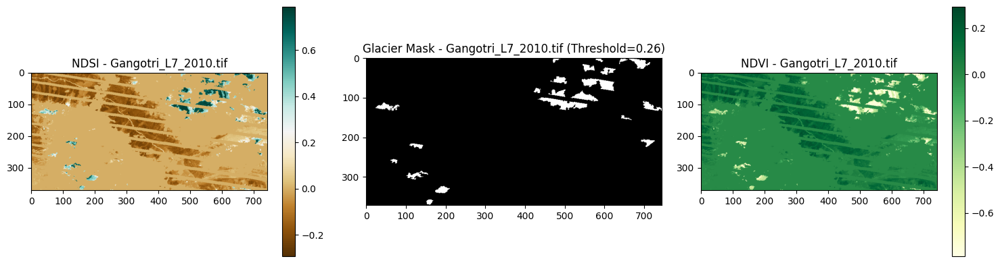

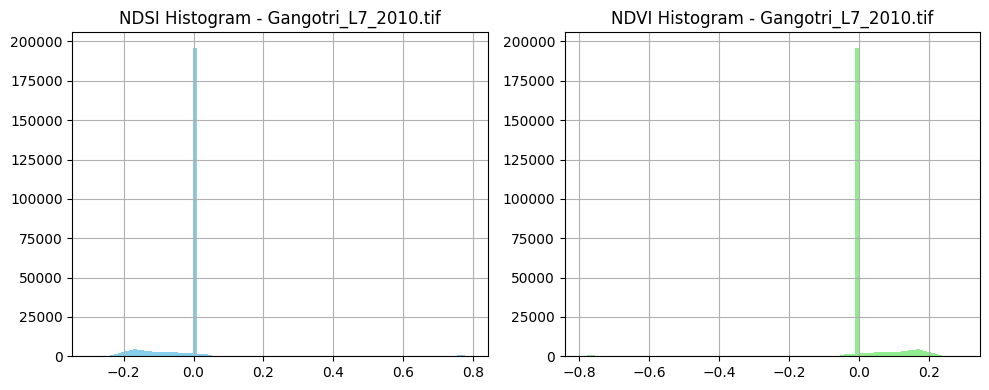

[✓] Gangotri_LS2_2016.tif | Area: 210816.000 | Threshold: -0.111


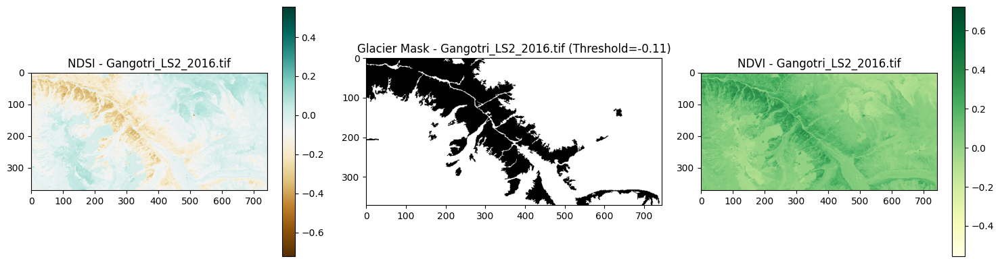

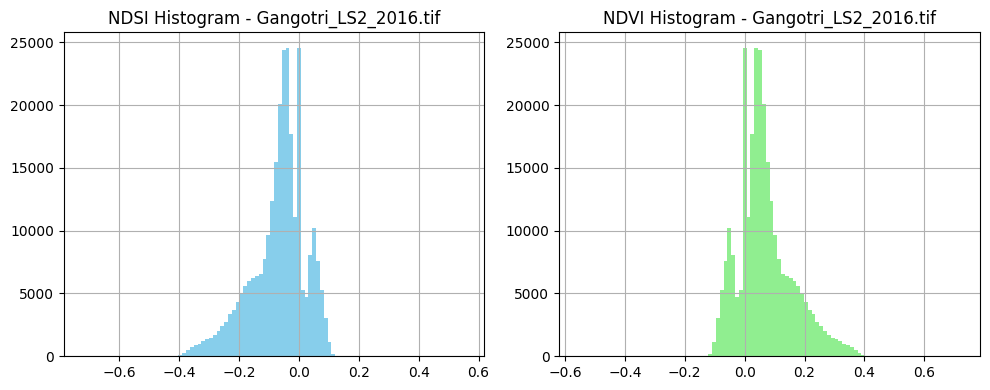

[✓] Gangotri_LS2_2017.tif | Area: 191498.000 | Threshold: -0.080


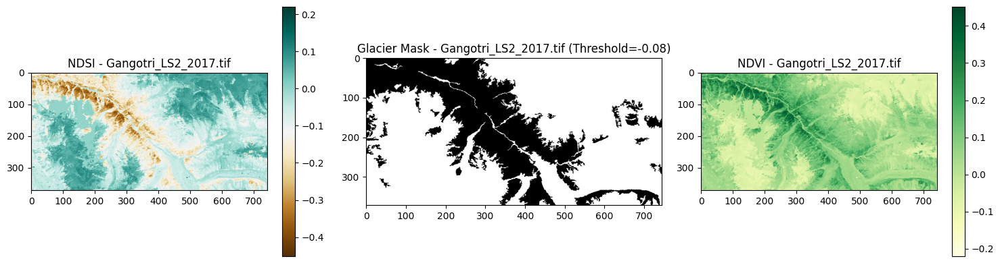

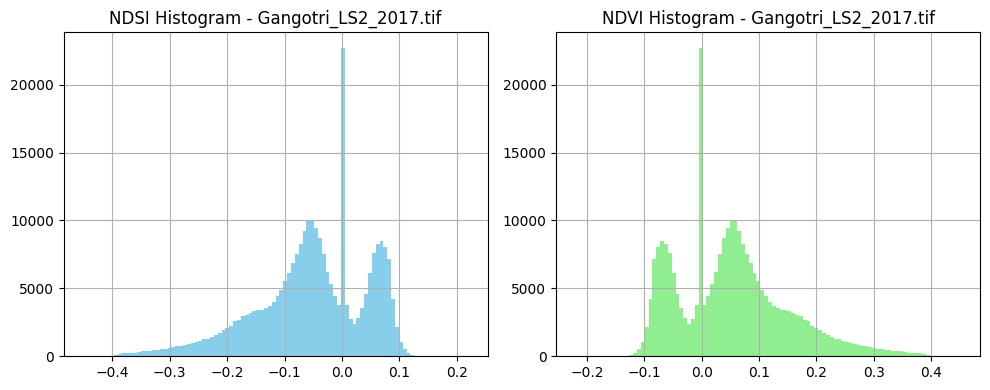

[✓] Gangotri_LS2_2018.tif | Area: 206001.000 | Threshold: -0.098


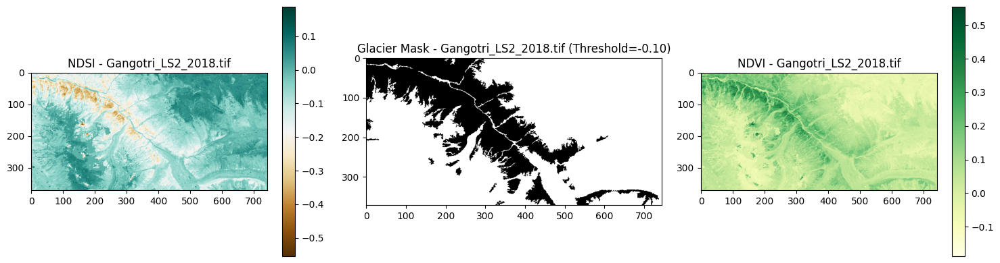

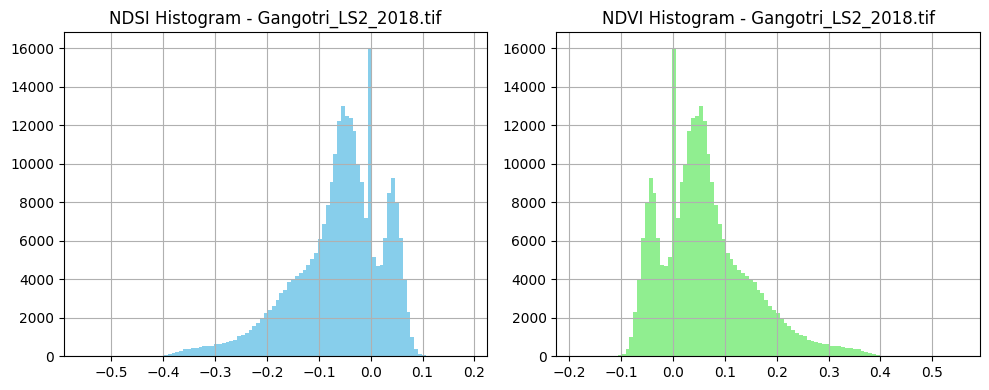

[✓] Gangotri_LS2_2019.tif | Area: 233371.000 | Threshold: -0.180


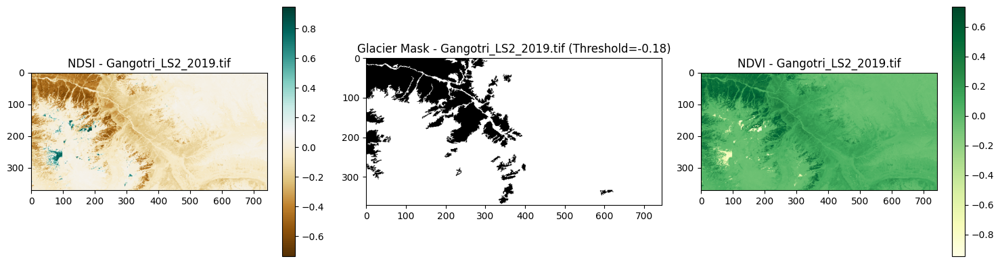

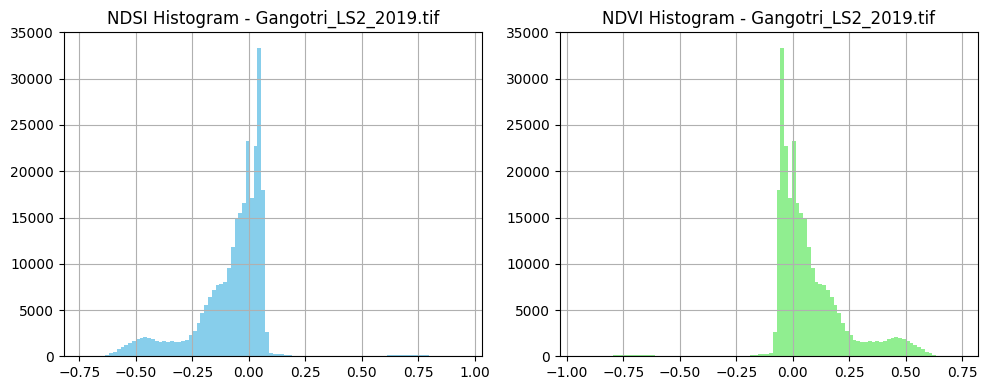

[✓] Gangotri_LS2_2020.tif | Area: 236586.000 | Threshold: -0.172


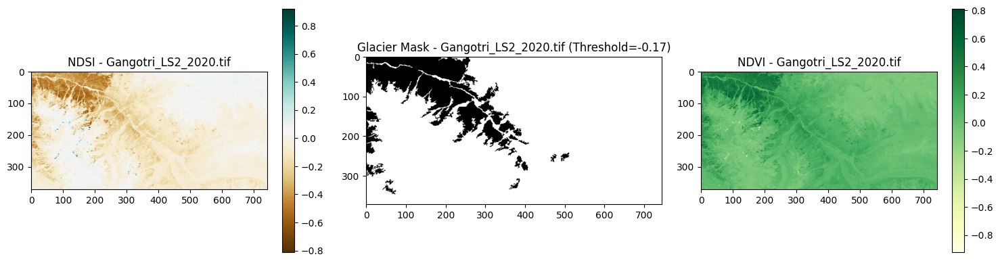

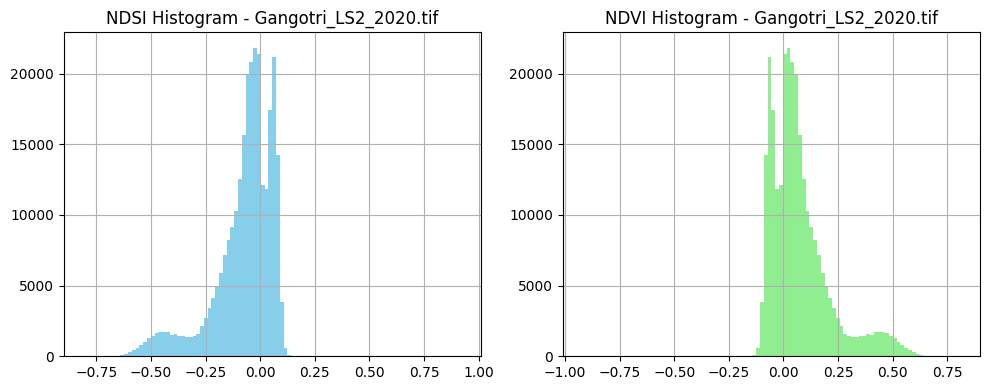

[✓] Gangotri_LS2_2021.tif | Area: 197521.000 | Threshold: -0.137


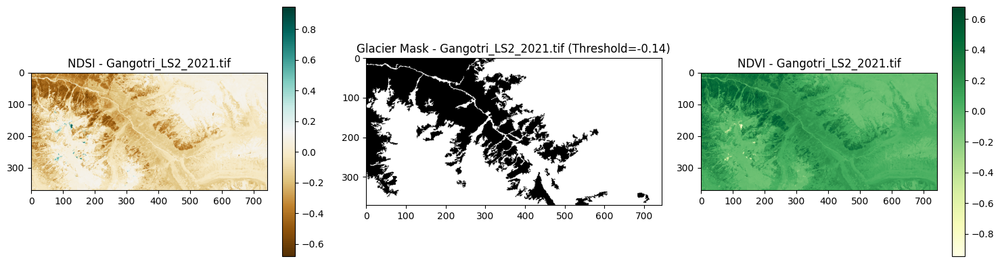

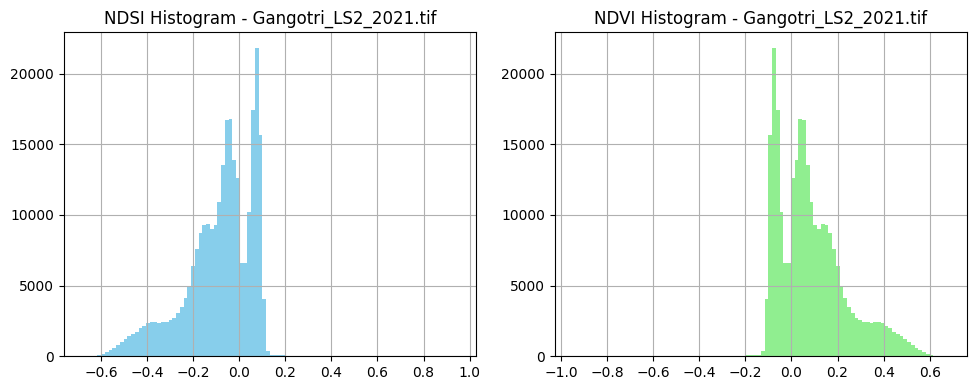

[✓] Gangotri_LS2_2022.tif | Area: 182904.000 | Threshold: -0.139


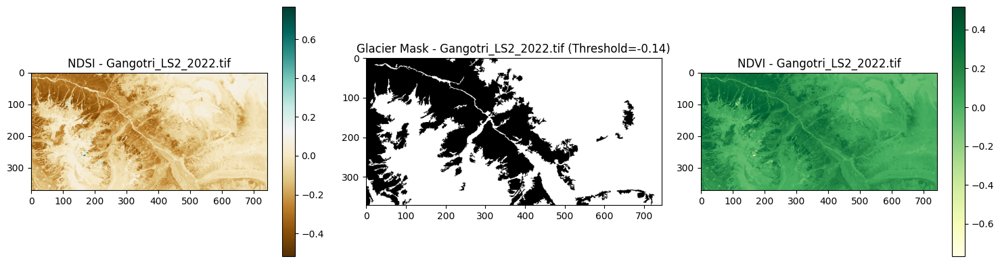

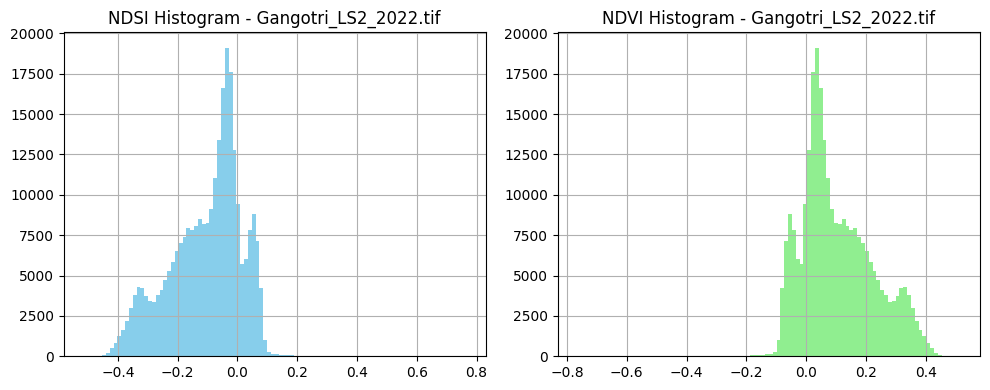

[✓] Gangotri_LS2_2023.tif | Area: 188612.000 | Threshold: -0.111


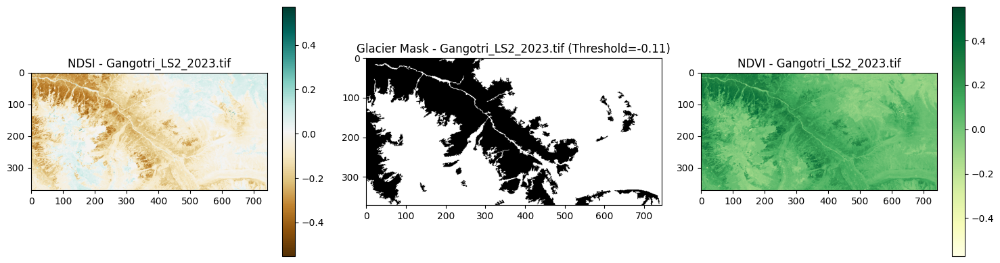

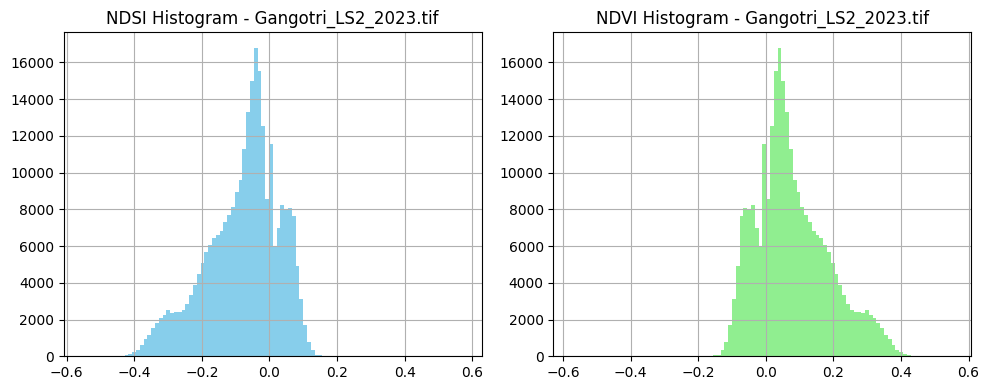

[✓] Gangotri_LS2_2024.tif | Area: 183181.000 | Threshold: -0.119


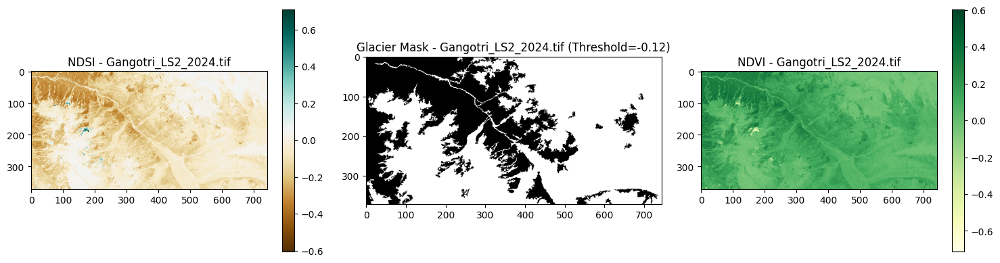

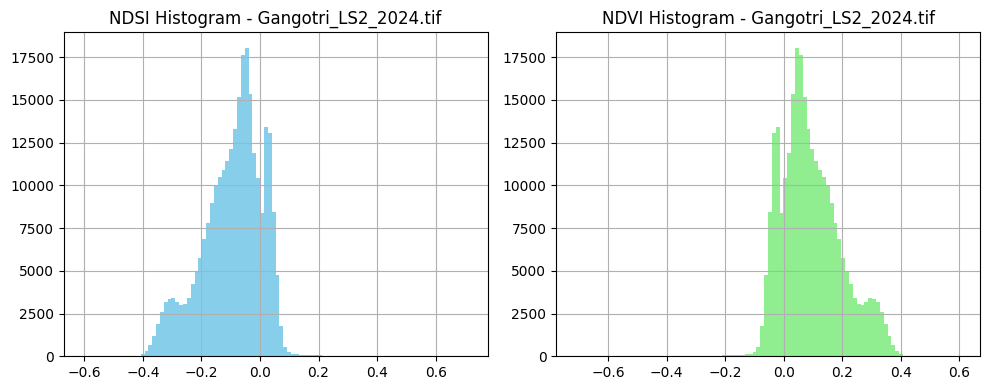

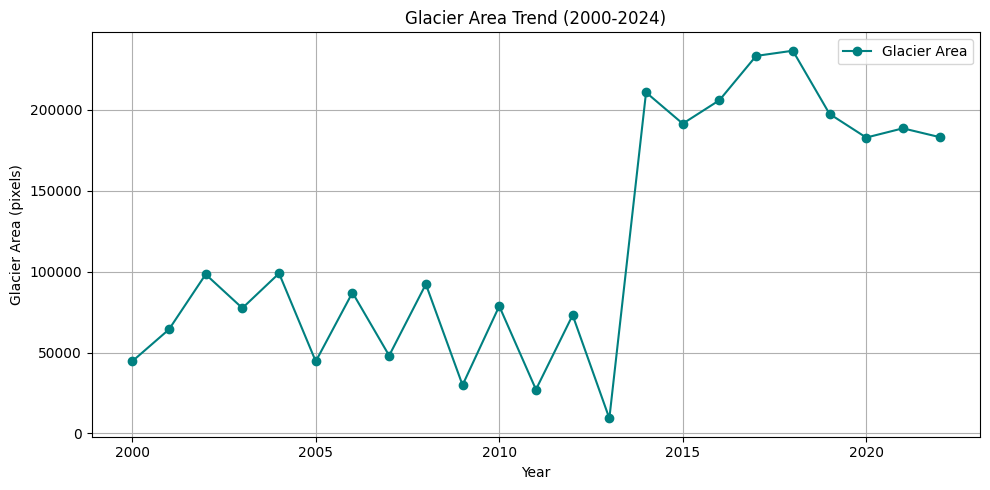

In [ ]:
import os
import numpy as np
import rasterio
import matplotlib.pyplot as plt
from rasterio.plot import show
from skimage.filters import threshold_otsu
from skimage.morphology import remove_small_objects, remove_small_holes
from skimage.measure import label
import pandas as pd

# -------- CONFIG ---------
image_path = '/content/drive/MyDrive/GEE_Gangotri_Exports_1'
mask_output_path = '/content/drive/MyDrive/Glacier_Masks2'
os.makedirs(mask_output_path, exist_ok=True)

image_files = sorted([f for f in os.listdir(image_path) if f.endswith('.tif')])
years = list(range(2000, 2000 + len(image_files)))

# ----- Compute NDSI -----
def calculate_ndsi(image):
    green = image[0].astype(np.float32)  # Band 1 (Green)
    swir = image[2].astype(np.float32)   # Band 3 (SWIR1)
    epsilon = 1e-10
    ndsi = (green - swir) / (green + swir + epsilon)
    return np.nan_to_num(ndsi)

# ----- Compute NDVI -----
def calculate_ndvi(image):
    nir = image[2].astype(np.float32) if image.shape[0] > 3 else image[2].astype(np.float32)
    red = image[0].astype(np.float32) if image.shape[0] > 3 else image[0].astype(np.float32)
    epsilon = 1e-10
    ndvi = (nir - red) / (nir + red + epsilon)
    return np.nan_to_num(ndvi)

# ----- Glacier Mask with NDVI Filter -----
def create_glacier_mask(ndsi, ndvi):
    try:
        threshold = threshold_otsu(ndsi)
    except:
        threshold = 0.4  # fallback

    mask = (ndsi > threshold) & (ndvi < 0.2)
    # Morphological cleanup
    labeled = label(mask)
    mask_cleaned = remove_small_objects(labeled, min_size=100)
    mask_cleaned = remove_small_holes(mask_cleaned, area_threshold=100)
    return mask_cleaned.astype(np.uint8), threshold

# ----- Save Mask as GeoTIFF -----
def save_mask(mask, reference, output_path):
    with rasterio.open(
        output_path, 'w',
        driver='GTiff',
        height=mask.shape[0],
        width=mask.shape[1],
        count=1,
        dtype='uint8',
        crs=reference.crs,
        transform=reference.transform
    ) as dst:
        dst.write(mask, 1)

# ----- Main Loop -----
glacier_areas_raw = []

for i, f in enumerate(image_files):
    file_path = os.path.join(image_path, f)
    with rasterio.open(file_path) as src:
        img = src.read()
        ndsi = calculate_ndsi(img)
        ndvi = calculate_ndvi(img)

        glacier_mask, used_threshold = create_glacier_mask(ndsi, ndvi)
        glacier_area = np.sum(glacier_mask)
        glacier_areas_raw.append(glacier_area)

        print(f"[✓] {f} | Area: {glacier_area:.3f} | Threshold: {used_threshold:.3f}")

        # Save mask
        mask_filename = f"glacier_mask_{years[i]}.tif"
        save_mask(glacier_mask, src, os.path.join(mask_output_path, mask_filename))

        # Visualization
        plt.figure(figsize=(15, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(ndsi, cmap='BrBG')
        plt.title(f'NDSI - {f}')
        plt.colorbar()

        plt.subplot(1, 3, 2)
        plt.imshow(glacier_mask, cmap='gray')
        plt.title(f'Glacier Mask - {f} (Threshold={used_threshold:.2f})')

        plt.subplot(1, 3, 3)
        plt.imshow(ndvi, cmap='YlGn')
        plt.title(f'NDVI - {f}')
        plt.colorbar()

        plt.tight_layout()
        plt.show()
        plt.figure(figsize=(10, 4))
        plt.subplot(1, 2, 1)
        plt.hist(ndsi.flatten(), bins=100, color='skyblue')
        plt.title(f'NDSI Histogram - {f}')
        plt.grid(True)

        plt.subplot(1, 2, 2)
        plt.hist(ndvi.flatten(), bins=100, color='lightgreen')
        plt.title(f'NDVI Histogram - {f}')
        plt.grid(True)

        plt.tight_layout()
        plt.show()

# ----- Keep All Years for Plotting -----
all_years = years
all_areas = glacier_areas_raw

# ----- Plot All Glacier Area Trend -----
plt.figure(figsize=(10, 5))
plt.plot(all_years, all_areas, marker='o', color='teal', label='Glacier Area')
plt.title("Glacier Area Trend (2000-2024)")
plt.xlabel("Year")
plt.ylabel("Glacier Area (pixels)")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

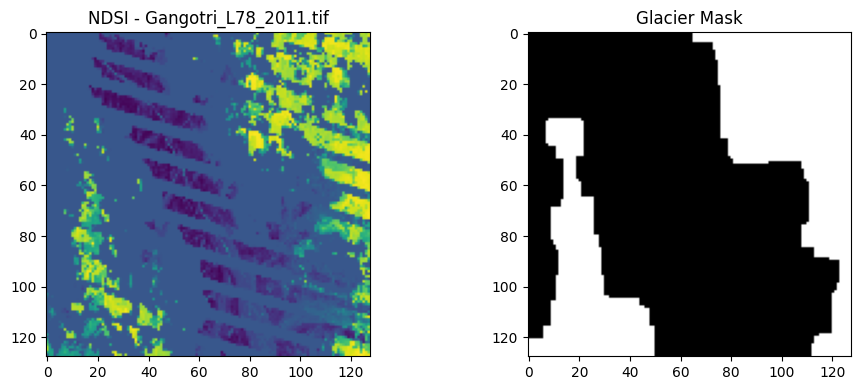

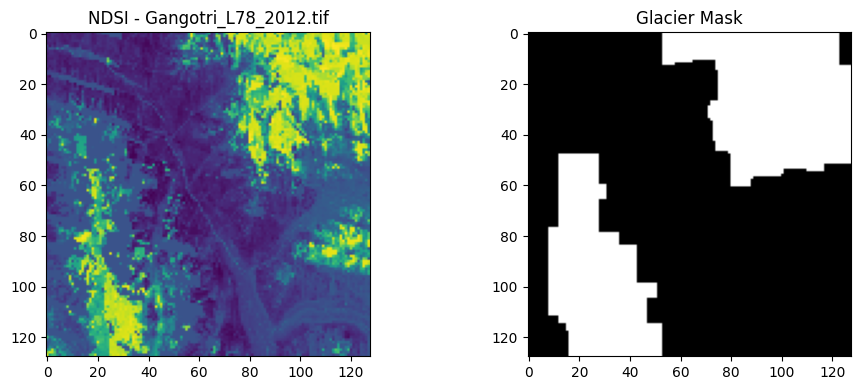

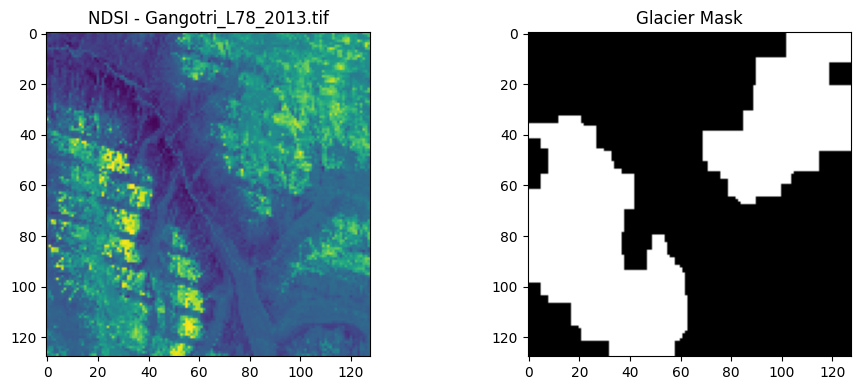

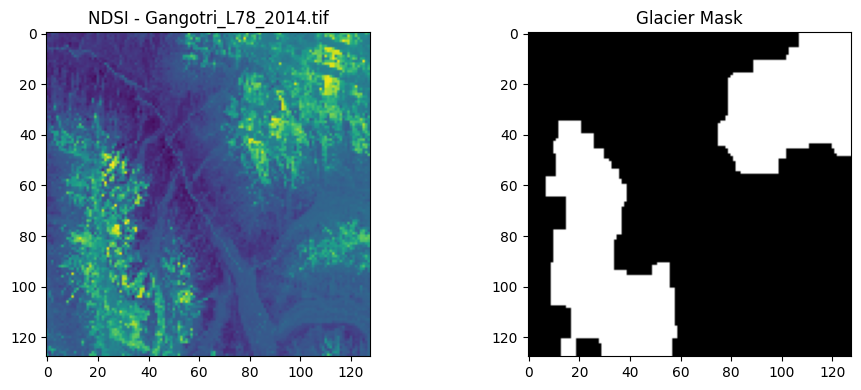

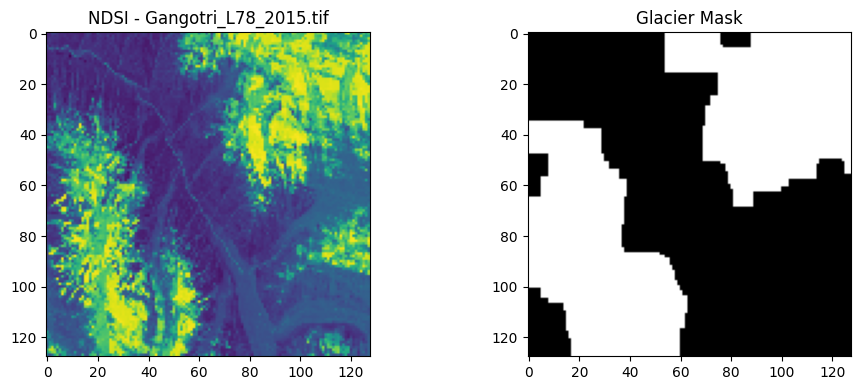

...

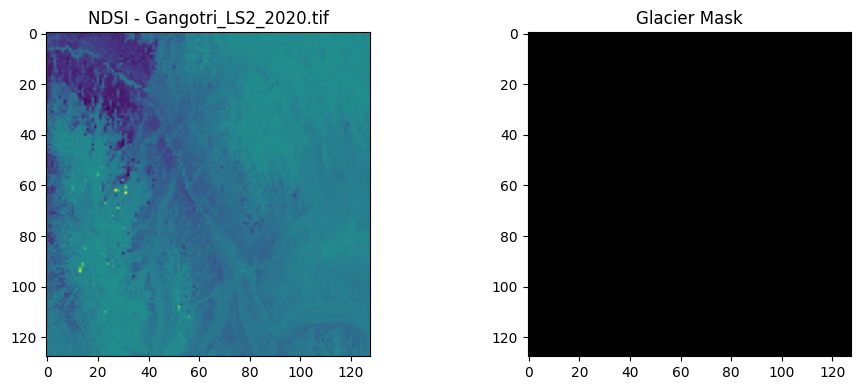

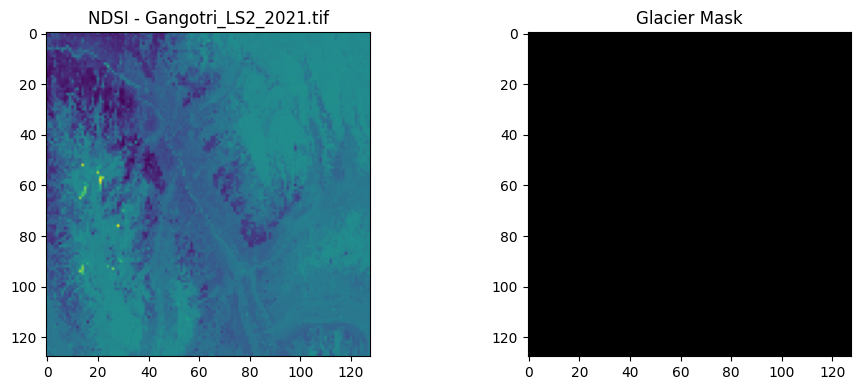

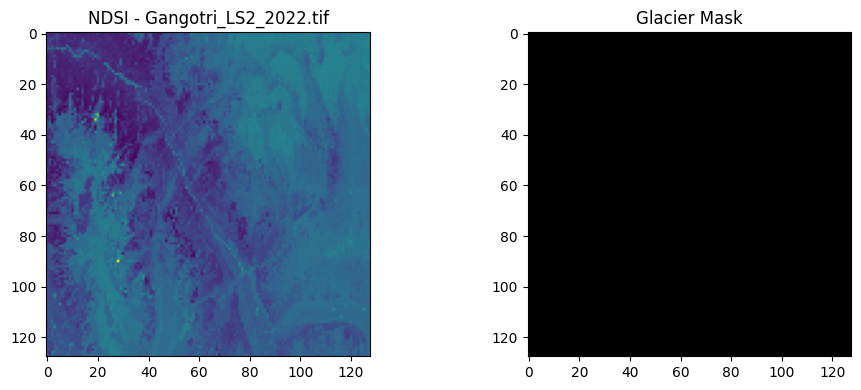

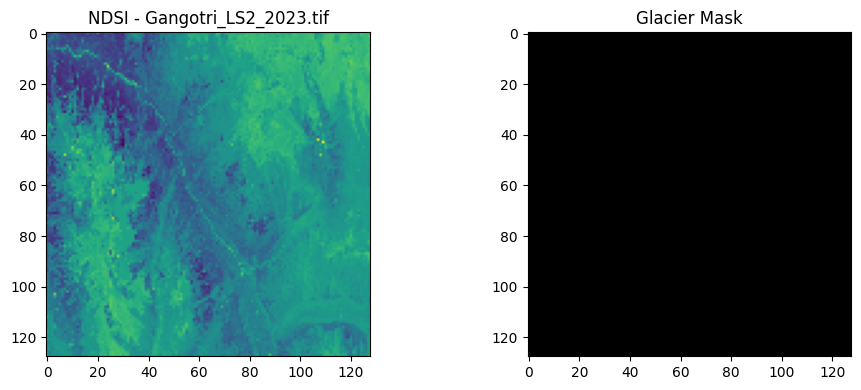

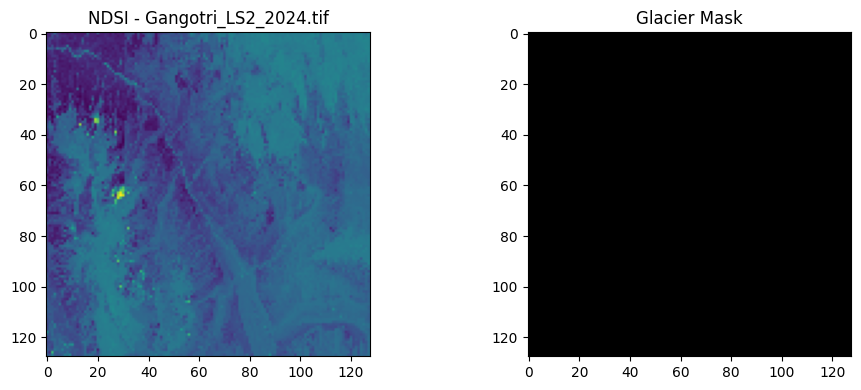

Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.7441 - loss: 0.6931

1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step - accuracy: 0.7441 - loss: 0.6931 - val_accuracy: 0.7998 - val_loss: 0.6901
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - accuracy: 0.8064 - loss: 0.6900 - val_accuracy: 0.7998 - val_loss: 0.6845
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step - accuracy: 0.8064 - loss: 0.6843 - val_accuracy: 0.7998 - val_loss: 0.6755
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - accuracy: 0.8064 - loss: 0.6751 - val_accuracy: 0.7998 - val_loss: 0.6602
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - accuracy: 0.8064 - loss: 0.6596 - val_accuracy: 0.7998 - val_loss: 0.6361
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - accuracy: 0.8064 - loss: 0.6351 - val_accuracy: 0.7998 - val_loss: 0.6025
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step - accuracy: 0.8064 - loss: 0.6008 - val_accuracy: 0.7998 - val_loss: 0.5597
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - accuracy: 0.8064 - loss: 0.5570 - val_accuracy: 0.7998 - val_loss: 0.5181
Epoch 9/10
1/1 ━━━━━━━━━━━━

Validation Accuracy: 0.7998
Model saved as 'glacier_unet_model.h5'


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import rasterio
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Directory with multi-year glacier TIFF images
tiff_directory = '/content/drive/MyDrive/GEE_Gangotri_Exports_1'

# ----- Compute NDSI -----
def calculate_ndsi(image):
    green = image[0].astype(np.float32)  # Band 1 (Green)
    swir = image[2].astype(np.float32)   # Band 3 (SWIR1)
    epsilon = 1e-10
    ndsi = (green - swir) / (green + swir + epsilon)
    return np.nan_to_num(ndsi)

def create_glacier_mask(ndsi, threshold=0.4):
    raw_mask = (ndsi > threshold).astype(np.uint8)
    sobel_x = cv2.Sobel(raw_mask.astype(np.float32), cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(raw_mask.astype(np.float32), cv2.CV_64F, 0, 1, ksize=3)
    edges = np.hypot(sobel_x, sobel_y).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    refined = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel, iterations=2)
    refined = cv2.morphologyEx(refined, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(refined, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(refined)
    for contour in contours:
        if cv2.contourArea(contour) > 500:
            cv2.drawContours(mask, [contour], -1, (1), thickness=cv2.FILLED)
    return mask

def load_images_and_masks(tiff_directory):
    images, masks = [], []
    for filename in sorted(os.listdir(tiff_directory)):
        if filename.endswith('.tif'):
            path = os.path.join(tiff_directory, filename)
            with rasterio.open(path) as dataset:
                bands = dataset.read()
            ndsi = calculate_ndsi(bands)
            img_resized = cv2.resize(ndsi, (128, 128))
            mask = create_glacier_mask(img_resized)
            images.append(img_resized)
            masks.append(mask)
            plot_glacier_mask(img_resized, filename, mask)
    return np.array(images), np.array(masks)

def plot_glacier_mask(ndsi, filename, mask):
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(ndsi, cmap='viridis')
    plt.title(f"NDSI - {filename}")
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.title("Glacier Mask")
    plt.tight_layout()
    plt.show()

images, masks = load_images_and_masks(tiff_directory)
images = images.astype('float32') / 255.0
masks = masks.astype('float32')

X_train, X_val, y_train, y_val = train_test_split(images, masks, test_size=0.2, random_state=42)
X_train = X_train.reshape(-1, 128, 128, 1)
X_val = X_val.reshape(-1, 128, 128, 1)
y_train = y_train.reshape(-1, 128, 128, 1)
y_val = y_val.reshape(-1, 128, 128, 1)


def build_unet(input_shape):
    inputs = layers.Input(shape=input_shape)
    c1 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    p1 = layers.MaxPooling2D((2, 2))(c1)

    c2 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    p2 = layers.MaxPooling2D((2, 2))(c2)

    c3 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p2)

    u1 = layers.UpSampling2D((2, 2))(c3)
    concat1 = layers.Concatenate()([u1, c2])
    c4 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(concat1)

    u2 = layers.UpSampling2D((2, 2))(c4)
    concat2 = layers.Concatenate()([u2, c1])
    c5 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(concat2)

    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(c5)
    model = models.Model(inputs, outputs)
    return model

# Build and compile model
model = build_unet((128, 128, 1))
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train model
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_val, y_val))

# Evaluate model
val_loss, val_acc = model.evaluate(X_val, y_val)
print(f"Validation Accuracy: {val_acc:.4f}")

# Save model
model.save("glacier_unet_model.h5")
print("Model saved as 'glacier_unet_model.h5'")


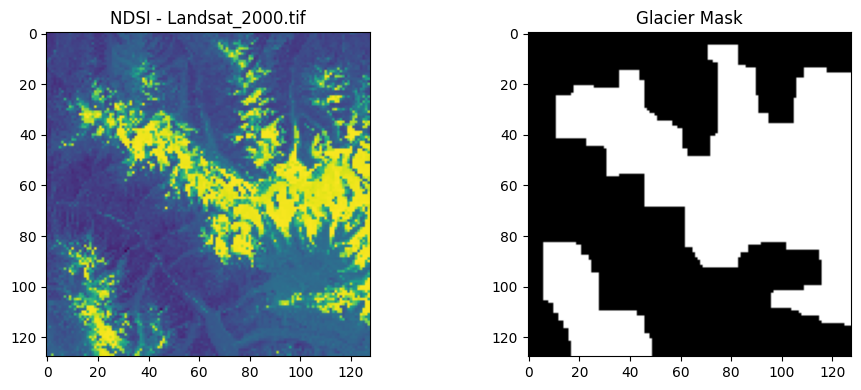

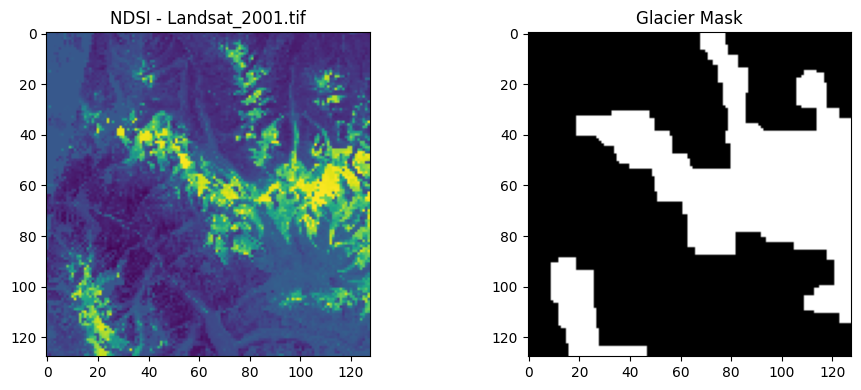

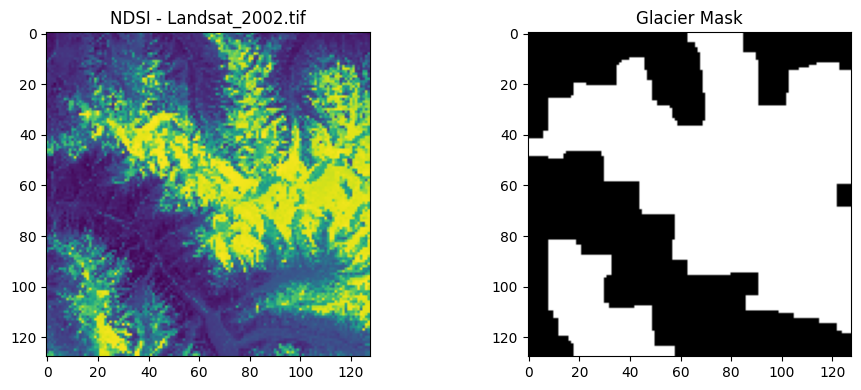

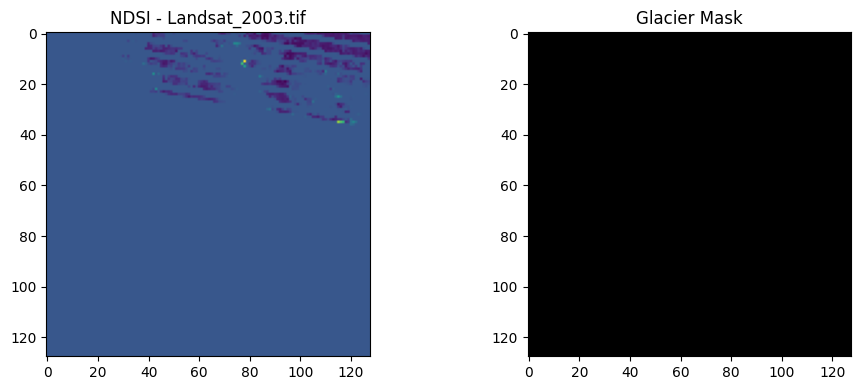

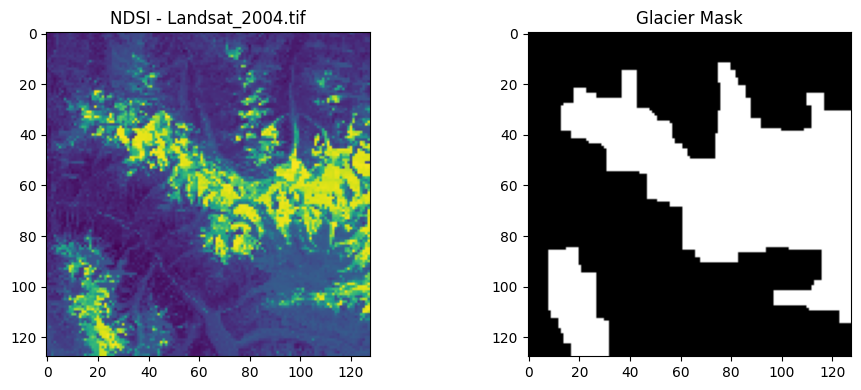

...

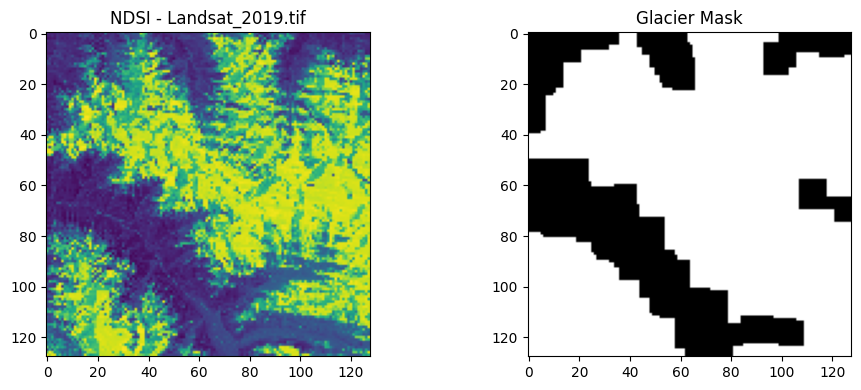

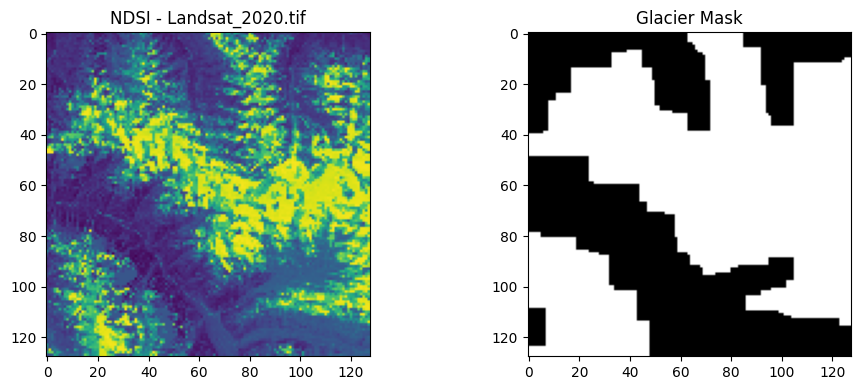

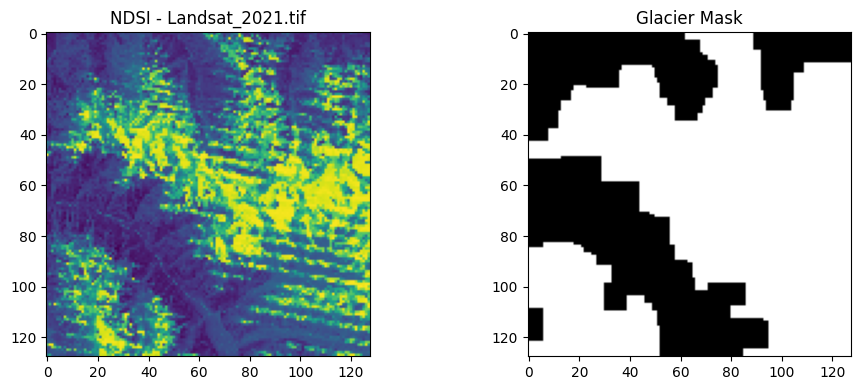

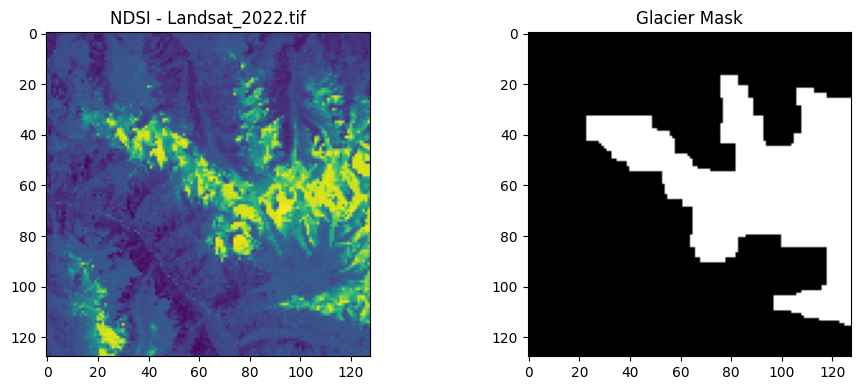

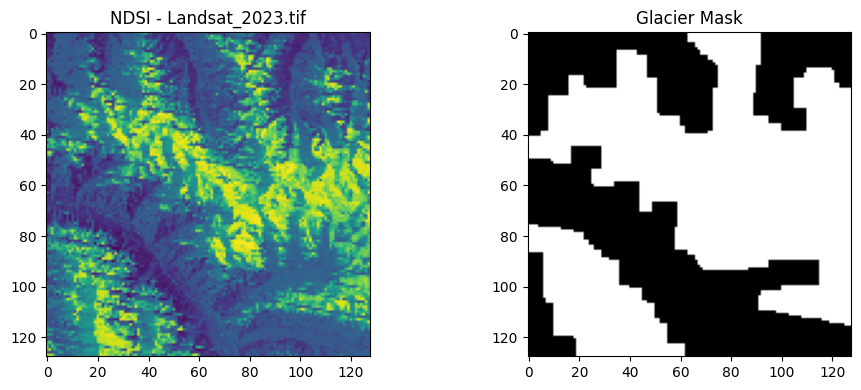

Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step - accuracy: 0.8110 - loss: 0.6931 - val_accuracy: 0.4225 - val_loss: 0.6931
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - accuracy: 0.5016 - loss: 0.6927 - val_accuracy: 0.4225 - val_loss: 0.6929
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step - accuracy: 0.5016 - loss: 0.6925 - val_accuracy: 0.4225 - val_loss: 0.6930
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step - accuracy: 0.5016 - loss: 0.6921 - val_accuracy: 0.4271 - val_loss: 0.6922
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - accuracy: 0.5049 - loss: 0.6915 - val_accuracy: 0.4290 - val_loss: 0.6918
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - accuracy: 0.5070 - loss: 0.6907 - val_accuracy: 0.4605 - val_loss: 0.6907
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - accuracy: 0.5282 - loss: 0.6895 - val_accuracy: 0.6969 - val_loss: 0.6890
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step - accuracy: 0.7187 - loss: 0.6878 - val_accuracy: 0.4258 - val_loss: 0.6903
Epoch 9/10
1/1 ━

Validation Accuracy: 0.9263
Model saved as 'glacier_unet_model.h5'


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import rasterio
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Directory with multi-year glacier TIFF images
tiff_directory = '/content/drive/MyDrive/GEE_Gangotri_Exports/Satellite_Imagery_2'

# ----- Compute NDSI -----
def calculate_ndsi(image):
    green = image[0].astype(np.float32)  # Band 1 (Green)
    swir = image[2].astype(np.float32)   # Band 3 (SWIR1)
    epsilon = 1e-10
    ndsi = (green - swir) / (green + swir + epsilon)
    return np.nan_to_num(ndsi)

def create_glacier_mask(ndsi, threshold=0.4):
    raw_mask = (ndsi > threshold).astype(np.uint8)
    sobel_x = cv2.Sobel(raw_mask.astype(np.float32), cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(raw_mask.astype(np.float32), cv2.CV_64F, 0, 1, ksize=3)
    edges = np.hypot(sobel_x, sobel_y).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    refined = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel, iterations=2)
    refined = cv2.morphologyEx(refined, cv2.MORPH_OPEN, kernel, iterations=1)
    contours, _ = cv2.findContours(refined, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(refined)
    for contour in contours:
        if cv2.contourArea(contour) > 500:
            cv2.drawContours(mask, [contour], -1, (1), thickness=cv2.FILLED)
    return mask

def load_images_and_masks(tiff_directory):
    images, masks = [], []
    for filename in sorted(os.listdir(tiff_directory)):
        if filename.endswith('.tif'):
            path = os.path.join(tiff_directory, filename)
            with rasterio.open(path) as dataset:
                bands = dataset.read()
            ndsi = calculate_ndsi(bands)
            img_resized = cv2.resize(ndsi, (128, 128))
            mask = create_glacier_mask(img_resized)
            images.append(img_resized)
            masks.append(mask)
            plot_glacier_mask(img_resized, filename, mask)
    return np.array(images), np.array(masks)

def plot_glacier_mask(ndsi, filename, mask):
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(ndsi, cmap='viridis')
    plt.title(f"NDSI - {filename}")
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='gray')
    plt.title("Glacier Mask")
    plt.tight_layout()
    plt.show()

images, masks = load_images_and_masks(tiff_directory)
images = images.astype('float32') / 255.0
masks = masks.astype('float32')

X_train, X_val, y_train, y_val = train_test_split(images, masks, test_size=0.2, random_state=42)
X_train = X_train.reshape(-1, 128, 128, 1)
X_val = X_val.reshape(-1, 128, 128, 1)
y_train = y_train.reshape(-1, 128, 128, 1)
y_val = y_val.reshape(-1, 128, 128, 1)


def build_unet(input_shape):
    inputs = layers.Input(shape=input_shape)
    c1 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    p1 = layers.MaxPooling2D((2, 2))(c1)

    c2 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    p2 = layers.MaxPooling2D((2, 2))(c2)

    c3 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p2)

    u1 = layers.UpSampling2D((2, 2))(c3)
    concat1 = layers.Concatenate()([u1, c2])
    c4 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(concat1)

    u2 = layers.UpSampling2D((2, 2))(c4)
    concat2 = layers.Concatenate()([u2, c1])
    c5 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(concat2)

    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(c5)
    model = models.Model(inputs, outputs)
    return model

# Build and compile model
model = build_unet((128, 128, 1))
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train model
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_val, y_val))

# Evaluate model
val_loss, val_acc = model.evaluate(X_val, y_val)
print(f"Validation Accuracy: {val_acc:.4f}")

# Save model
model.save("glacier_unet_model.h5")
print("Model saved as 'glacier_unet_model.h5'")

In [ ]:

def predict_glacier_mask(tiff_path, model_path="glacier_unet_model.h5"):
    # Load the trained model
    model = load_model(model_path)

    # Read and preprocess the TIFF image
    with rasterio.open(tiff_path) as dataset:
        bands = dataset.read()  # shape: (bands, H, W)

    ndsi = calculate_ndsi(bands)
    ndsi_resized = cv2.resize(ndsi, (128, 128)).astype('float32') / 255.0
    input_img = ndsi_resized.reshape(1, 128, 128, 1)

    # Predict glacier mask
    predicted_mask = model.predict(input_img)[0, :, :, 0]

    # Threshold the prediction to get binary mask
    binary_mask = (predicted_mask > 0.5).astype(np.uint8)

    # Plot prediction
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.imshow(ndsi_resized, cmap='viridis')
    plt.title("NDSI Input")

    plt.subplot(1, 3, 2)
    plt.imshow(predicted_mask, cmap='hot')
    plt.title("Predicted Mask (Raw)")

    plt.subplot(1, 3, 3)
    plt.imshow(binary_mask, cmap='gray')
    plt.title("Thresholded Glacier Mask")

    plt.tight_layout()
    plt.show()

    return binary_mask

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


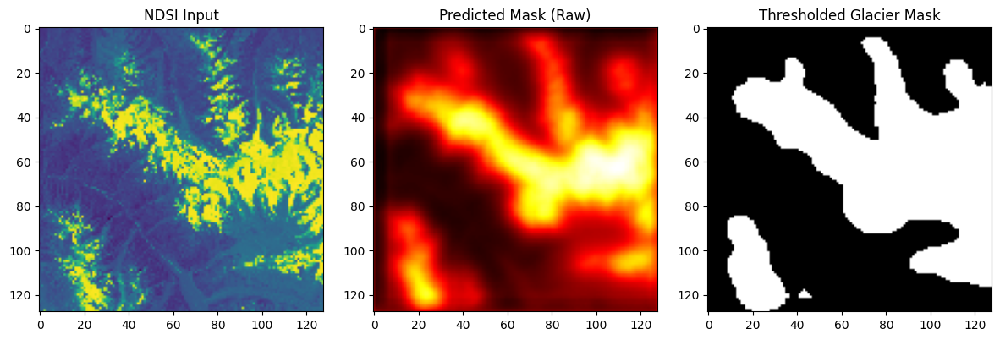

In [ ]:
test_tiff = '/content/drive/MyDrive/GEE_Gangotri_Exports/Satellite_Imagery_2/Landsat_2000.tif'
predicted_mask = predict_glacier_mask(test_tiff)


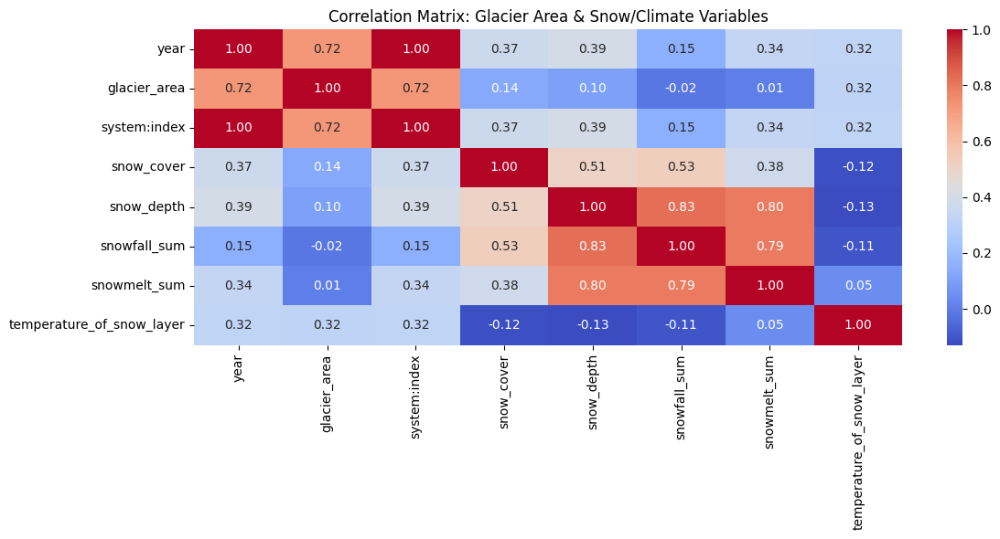


Top Correlations with Glacier Area:
glacier_area                 1.000000
year                         0.723083
system:index                 0.723083
temperature_of_snow_layer    0.320264
snow_cover                   0.135573
snow_depth                   0.102943
snowmelt_sum                 0.005678
snowfall_sum                -0.016453
Name: glacier_area, dtype: float64


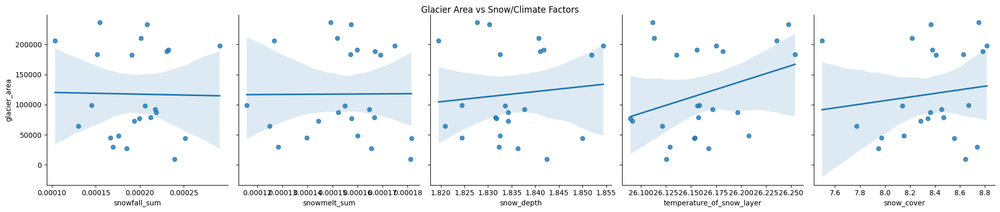


Linear Regression Results:
R² Score: 0.20092638137446794
Intercept: -23985455.07735908
Coefficients:
  snowfall_sum: -485008174.51
  snowmelt_sum: -1059724433.58
  snow_depth: 4006639.91
  temperature_of_snow_layer: 638003.35
  snow_cover: 38027.84


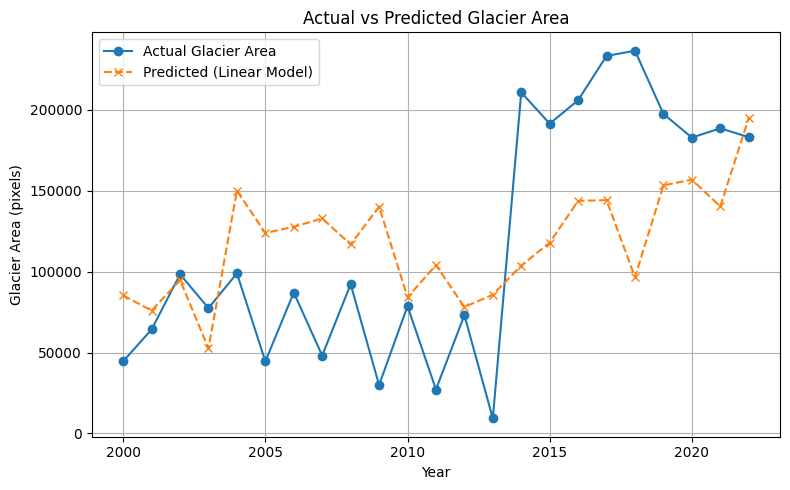

In [ ]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score


glacier_area_df = pd.DataFrame({
    'year': all_years,
    'glacier_area': all_areas
})

# -------- LOAD GEE SNOW/CLIMATE CSV --------
gee_data_path = '/content/drive/MyDrive/GEE_Gangotri_Exports/Gangotri_Snow_2000_2024.csv'
climate_df = pd.read_csv(gee_data_path)

# -------- MERGE --------
df = pd.merge(glacier_area_df, climate_df, on='year')

# -------- CORRELATION MATRIX --------
plt.figure(figsize=(12, 6))
corr_matrix = df.corr(numeric_only=True)
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix: Glacier Area & Snow/Climate Variables")
plt.tight_layout()
plt.show()

# -------- DISPLAY CORRELATIONS --------
print("\nTop Correlations with Glacier Area:")
print(corr_matrix['glacier_area'].sort_values(ascending=False))

# -------- PAIRPLOT --------
selected_vars = [
    "snowfall_sum",
    "snowmelt_sum",
    "snow_depth",
    "temperature_of_snow_layer",
    "snow_cover"
]

sns.pairplot(df, x_vars=selected_vars, y_vars=["glacier_area"], kind='reg', height=4)
plt.suptitle("Glacier Area vs Snow/Climate Factors", y=1.02)
plt.show()

# -------- LINEAR REGRESSION MODEL --------
X = df[selected_vars]
y = df["glacier_area"]

model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)

# -------- MODEL RESULTS --------
print("\nLinear Regression Results:")
print("R² Score:", r2_score(y, y_pred))
print("Intercept:", model.intercept_)
print("Coefficients:")
for var, coef in zip(selected_vars, model.coef_):
    print(f"  {var}: {coef:.2f}")

# -------- PLOT ACTUAL VS PREDICTED --------
plt.figure(figsize=(8, 5))
plt.plot(df['year'], y, marker='o', label='Actual Glacier Area')
plt.plot(df['year'], y_pred, marker='x', linestyle='--', label='Predicted (Linear Model)')
plt.title("Actual vs Predicted Glacier Area")
plt.xlabel("Year")
plt.ylabel("Glacier Area (pixels)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


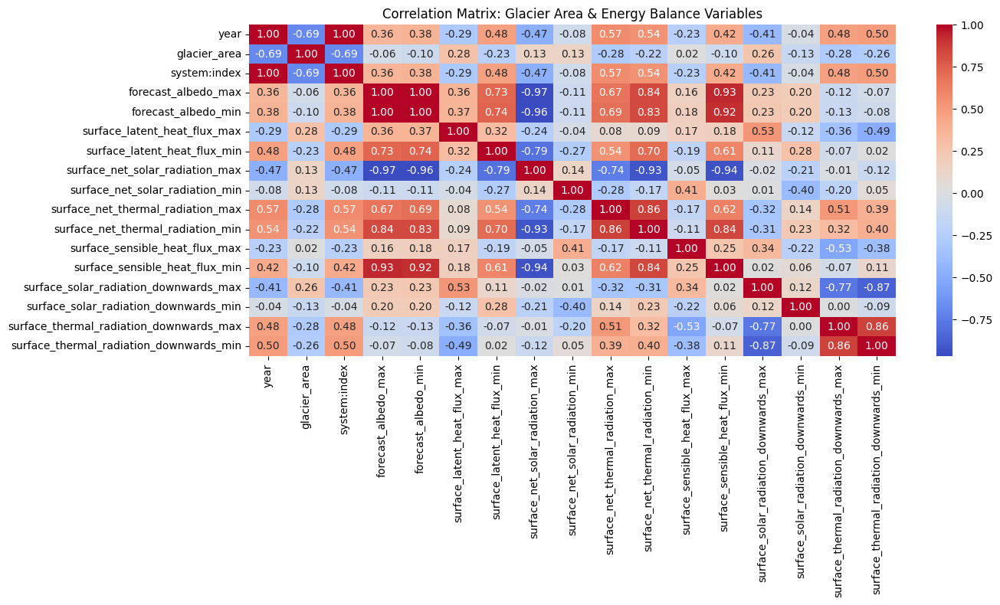


Top Correlations with Glacier Area:
glacier_area                               1.000000
surface_latent_heat_flux_max               0.281225
surface_solar_radiation_downwards_max      0.257771
surface_net_solar_radiation_max            0.134145
surface_net_solar_radiation_min            0.133076
surface_sensible_heat_flux_max             0.021668
forecast_albedo_max                       -0.060142
surface_sensible_heat_flux_min            -0.096899
forecast_albedo_min                       -0.102959
surface_solar_radiation_downwards_min     -0.131015
surface_net_thermal_radiation_min         -0.215964
surface_latent_heat_flux_min              -0.234097
surface_thermal_radiation_downwards_min   -0.264107
surface_thermal_radiation_downwards_max   -0.275484
surface_net_thermal_radiation_max         -0.281953
system:index                              -0.685302
year                                      -0.685302
Name: glacier_area, dtype: float64


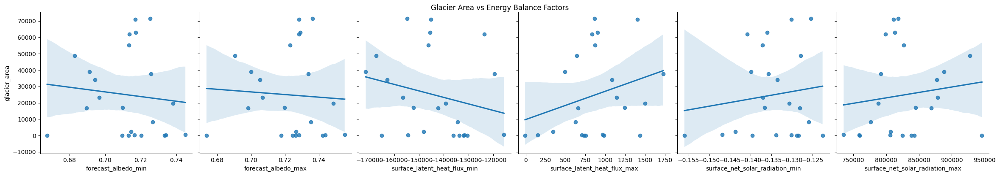


Linear Regression Results:
R² Score: 0.3673271007977751
Intercept: -1885.1482636767396
Coefficients:
  forecast_albedo_min: -5920040.15
  forecast_albedo_max: 5766279.26
  surface_latent_heat_flux_min: -0.44
  surface_latent_heat_flux_max: 23.62
  surface_net_solar_radiation_min: 225369.07
  surface_net_solar_radiation_max: 0.03


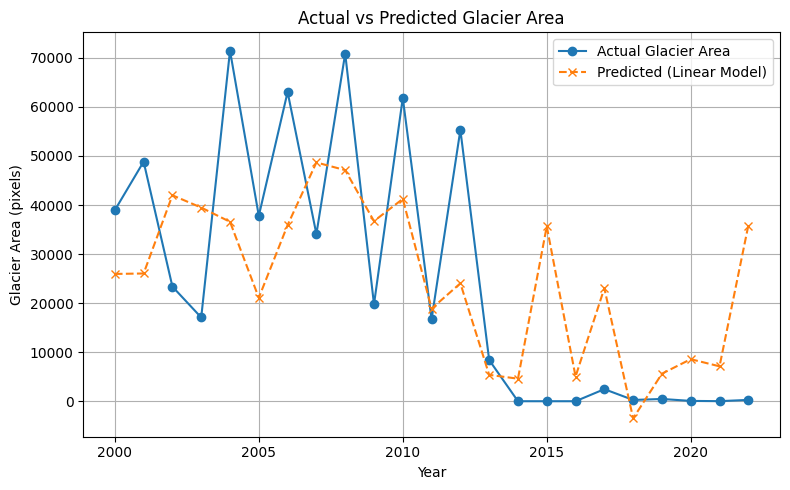

In [ ]:
# Re-import necessary packages after kernel reset
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score


glacier_area_df = pd.DataFrame({
    'year': all_years,
    'glacier_area': all_areas
})

# Load the GEE CSV file containing energy balance data
gee_data_path = '/content/drive/MyDrive/GEE_Gangotri_Exports/Gangotri_Energy_Albedo_2000_2024.csv'
climate_df = pd.read_csv(gee_data_path)

# Merge glacier area and climate data
df = pd.merge(glacier_area_df, climate_df, on='year')

# Plot correlation matrix
plt.figure(figsize=(14, 8))
corr_matrix = df.corr(numeric_only=True)
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix: Glacier Area & Energy Balance Variables")
plt.tight_layout()
plt.show()

# Display top correlations
print("\nTop Correlations with Glacier Area:")
print(corr_matrix['glacier_area'].sort_values(ascending=False))

# Selected variables for regression
selected_vars = [
    'forecast_albedo_min', 'forecast_albedo_max',
    'surface_latent_heat_flux_min', 'surface_latent_heat_flux_max',
    'surface_net_solar_radiation_min', 'surface_net_solar_radiation_max'
]

# Plot pairplot of selected variables
sns.pairplot(df, x_vars=selected_vars, y_vars=["glacier_area"], kind='reg', height=4)
plt.suptitle("Glacier Area vs Energy Balance Factors", y=1.02)
plt.show()

# Linear Regression
X = df[selected_vars]
y = df["glacier_area"]
model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)

# Model evaluation
print("\nLinear Regression Results:")
print("R² Score:", r2_score(y, y_pred))
print("Intercept:", model.intercept_)
print("Coefficients:")
for var, coef in zip(selected_vars, model.coef_):
    print(f"  {var}: {coef:.2f}")

# Plot actual vs predicted glacier area
plt.figure(figsize=(8, 5))
plt.plot(df['year'], y, marker='o', label='Actual Glacier Area')
plt.plot(df['year'], y_pred, marker='x', linestyle='--', label='Predicted (Linear Model)')
plt.title("Actual vs Predicted Glacier Area")
plt.xlabel("Year")
plt.ylabel("Glacier Area (pixels)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



In [ ]:
from google.colab import drive
drive.flush_and_unmount()
print('Drive unmounted')

Drive not mounted, so nothing to flush and unmount.
Drive unmounted


[Multiple Linear Regression using Snow + Radiation Variables]
R² Score: 0.4569310808801117
Intercept: 4130678.5405431762
Coefficients:
  temperature_of_snow_layer: -136880.21
  snow_cover: -21708.89
  snowfall_sum: 157761802.64
  snow_depth: -637877.25
  snowmelt_sum: -400077488.64
  surface_thermal_radiation_downwards_max: -0.82
  forecast_albedo_max: 7906485.61
  surface_thermal_radiation_downwards_min: 0.69
  forecast_albedo_min: -6789531.49
  surface_sensible_heat_flux_min: -1.03
  surface_solar_radiation_downwards_min: -414363.51
  surface_sensible_heat_flux_max: -1.53


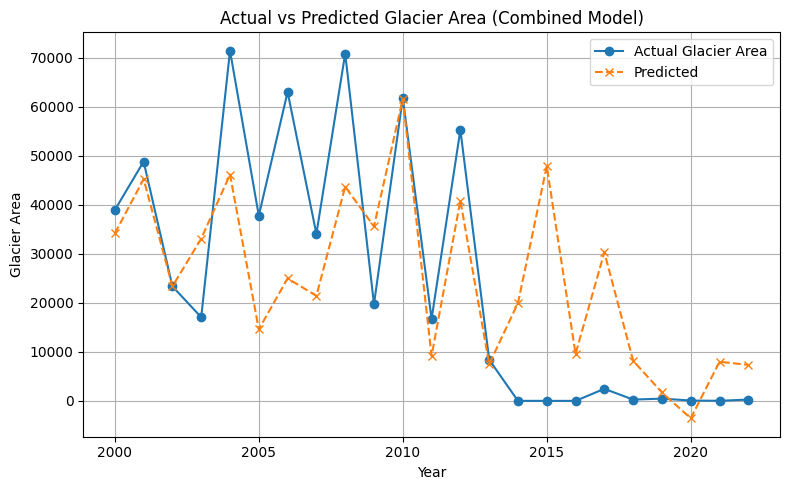

In [ ]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt

# Load glacier area data
glacier_area_df = pd.DataFrame({
    'year': all_years,
    'glacier_area': all_areas
})

# Load snow data
snow_path = '/content/drive/MyDrive/GEE_Gangotri_Exports/Gangotri_Snow_2000_2024.csv'
snow_df = pd.read_csv(snow_path)

# Load radiation data
radiation_path = '/content/drive/MyDrive/GEE_Gangotri_Exports/Gangotri_Energy_Albedo_2000_2024.csv'
radiation_df = pd.read_csv(radiation_path)

# Merge all on 'year'
df = glacier_area_df.merge(snow_df, on='year').merge(radiation_df, on='year')

# Select top correlated variables from both datasets
selected_vars_combined = [
    # Top snow correlations
    "temperature_of_snow_layer",
    "snow_cover",
    "snowfall_sum",
    "snow_depth",
    "snowmelt_sum",

    # Top radiation correlations
    "surface_thermal_radiation_downwards_max",
    "forecast_albedo_max",
    "surface_thermal_radiation_downwards_min",
    "forecast_albedo_min",
    "surface_sensible_heat_flux_min",
    "surface_solar_radiation_downwards_min",
    "surface_sensible_heat_flux_max"
]

# Drop any rows with missing values in selected columns
df_clean = df.dropna(subset=selected_vars_combined + ["glacier_area"])

# Run regression
X = df_clean[selected_vars_combined]
y = df_clean["glacier_area"]

model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)

# Results
print("[Multiple Linear Regression using Snow + Radiation Variables]")
print("R² Score:", r2_score(y, y_pred))
print("Intercept:", model.intercept_)
print("Coefficients:")
for var, coef in zip(selected_vars_combined, model.coef_):
    print(f"  {var}: {coef:.2f}")

# Plot
plt.figure(figsize=(8, 5))
plt.plot(df_clean['year'], y, marker='o', label='Actual Glacier Area')
plt.plot(df_clean['year'], y_pred, marker='x', linestyle='--', label='Predicted')
plt.title("Actual vs Predicted Glacier Area (Combined Model)")
plt.xlabel("Year")
plt.ylabel("Glacier Area")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Prepare feature matrix
X_vif = add_constant(df_clean[selected_vars_combined])

# Calculate VIFs
vif_data = pd.DataFrame()
vif_data["Feature"] = X_vif.columns
vif_data["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]

print("\nVariance Inflation Factor (VIF) for Each Feature:")
print(vif_data)



Variance Inflation Factor (VIF) for Each Feature:
                                    Feature           VIF
0                                     const  2.097525e+06
1                 temperature_of_snow_layer  6.907074e+00
2                                snow_cover  2.558845e+02
3                              snowfall_sum  2.174122e+01
4                                snow_depth  7.098846e+01
5                              snowmelt_sum  7.515755e+01
6   surface_thermal_radiation_downwards_max  5.959912e+00
7                       forecast_albedo_max  7.127338e+02
8   surface_thermal_radiation_downwards_min  1.068094e+01
9                       forecast_albedo_min  7.851925e+02
10           surface_sensible_heat_flux_min  8.132687e+01
11    surface_solar_radiation_downwards_min  1.727160e+00
12           surface_sensible_heat_flux_max  4.487131e+00


In [ ]:
selected_vars_reduced = [
    "temperature_of_snow_layer",  # Keep
    "snow_cover",                 # Keep
    "snowfall_sum",              # Keep
    "snow_depth",                # Keep
    "snowmelt_sum",              # Keep
    "surface_thermal_radiation_downwards_max",  # Keep, drop min
    "forecast_albedo_max",       # Keep, drop min
    "surface_sensible_heat_flux_min",  # Keep, drop max
    "surface_solar_radiation_downwards_min"     # Keep
]
from sklearn.linear_model import Ridge, Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Define features and target
X = df[selected_vars_reduced]
y = df["glacier_area"]

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Ridge Regression
ridge = Ridge(alpha=1.0)
ridge.fit(X_scaled, y)
y_ridge_pred = ridge.predict(X_scaled)

# Lasso Regression
lasso = Lasso(alpha=1.0)
lasso.fit(X_scaled, y)
y_lasso_pred = lasso.predict(X_scaled)

# Results
print("\n--- Ridge Regression ---")
print("R² Score:", r2_score(y, y_ridge_pred))
print("Coefficients:")
for var, coef in zip(selected_vars_reduced, ridge.coef_):
    print(f"  {var}: {coef:.2f}")

print("\n--- Lasso Regression ---")
print("R² Score:", r2_score(y, y_lasso_pred))
print("Coefficients:")
for var, coef in zip(selected_vars_reduced, lasso.coef_):
    print(f"  {var}: {coef:.2f}")



--- Ridge Regression ---
R² Score: 0.5399048580974218
Coefficients:
  temperature_of_snow_layer: 5662.18
  snow_cover: 1907.68
  snowfall_sum: 9920.07
  snow_depth: -9315.78
  snowmelt_sum: -9483.12
  surface_thermal_radiation_downwards_max: 4516.81
  forecast_albedo_max: 10220.74
  surface_sensible_heat_flux_min: -7462.34
  surface_solar_radiation_downwards_min: -6816.49

--- Lasso Regression ---
R² Score: 0.6567136242058513
Coefficients:
  temperature_of_snow_layer: 11457.06
  snow_cover: 0.00
  snowfall_sum: 17740.66
  snow_depth: -25874.57
  snowmelt_sum: -771.06
  surface_thermal_radiation_downwards_max: 1391.53
  forecast_albedo_max: 41630.40
  surface_sensible_heat_flux_min: -35029.35
  surface_solar_radiation_downwards_min: -9030.47


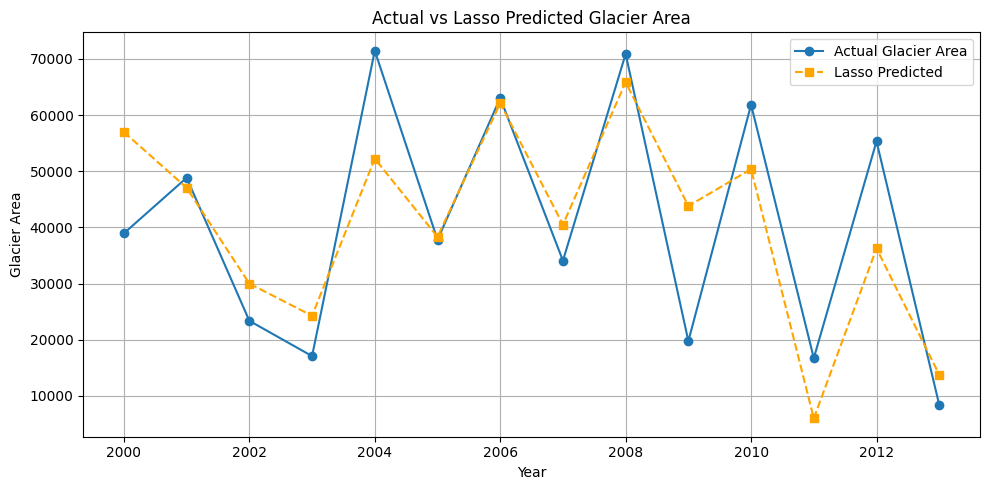

In [ ]:
import matplotlib.pyplot as plt


# --------- Lasso Prediction Plot ---------
plt.figure(figsize=(10, 5))
plt.plot(df['year'], df['glacier_area'], marker='o', label='Actual Glacier Area')
plt.plot(df['year'], lasso.predict(X_scaled), marker='s', linestyle='--', label='Lasso Predicted', color='orange')
plt.title('Actual vs Lasso Predicted Glacier Area')
plt.xlabel('Year')
plt.ylabel('Glacier Area')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
